# LightGBM

In [1]:
import numpy as np
import pandas as pd
from IPython.display import display, HTML
import importlib

import plotly.express as px
import matplotlib.pyplot as plt
import statsmodels.api as sm

from sklearn.metrics import mean_absolute_error, mean_squared_error, mean_absolute_percentage_error

import warnings
import os
import pickle

warnings.filterwarnings("ignore")
pd.options.display.float_format = '{:,.2f}'.format

In [2]:
df_main = pd.read_excel("https://raw.githubusercontent.com/carrenogf/MCD-Series-Temporales/main/dataset/series_diarias.xlsx")
df_main = df_main.sort_values("FECHA",ascending=True)
df_main.set_index("FECHA", inplace=True)
df_copa = df_main["CHU_COPA_AJUST"].dropna()
df_recprop = df_main["CHU_REC_PROPIOS_AJUST"].dropna()
df_regal = df_main["CHU_REGALIAS_AJUST"].dropna()
dataframes = [df_copa, df_recprop, df_regal]
titulos = ["CHU_COPA_AJUST", "CHU_REC_PROPIOS_AJUST", "CHU_REGALIAS_AJUST"]

In [3]:
def extract_time_features(index):
    return pd.Series({
        'dayofweek': index.dayofweek,
        'quarter': index.quarter,
        'month': index.month,
        'year': index.year,
        'dayofyear': index.dayofyear,
        'dayofmonth': index.day,
        'weekofyear': index.isocalendar().week
    })


def add_lags(df, titulo):
    target_map = df[titulo].to_dict()
    df['lag1'] = (df.index - pd.Timedelta('364 days')).map(target_map) # df_1['PJME_MW'].shift(1)
    df['lag2'] = (df.index - pd.Timedelta('728 days')).map(target_map) # df_1['PJME_MW'].shift(2)
    df['lag3'] = (df.index - pd.Timedelta('1092 days')).map(target_map) # df_1['PJME_MW'].shift(3)
    return df

In [4]:
time_features = dataframes[0].index.to_series().apply(extract_time_features)
dataframes[0] = pd.concat([dataframes[0], time_features], axis=1)
dataframes[0] = add_lags(dataframes[0], titulos[0])

time_features = dataframes[1].index.to_series().apply(extract_time_features)
dataframes[1] = pd.concat([dataframes[1], time_features], axis=1)
dataframes[1] = add_lags(dataframes[1], titulos[1])

time_features = dataframes[2].index.to_series().apply(extract_time_features)
dataframes[2] = pd.concat([dataframes[2], time_features], axis=1)
dataframes[2] = add_lags(dataframes[2], titulos[2])


In [5]:
dataframes[2].head()

,CHU_REGALIAS_AJUST,dayofweek,quarter,month,year,dayofyear,dayofmonth,weekofyear,lag1,lag2,lag3
FECHA,,,,,,,,,,,
2016-04-08,"212,159.00",4,2,4,2016,99,8,14,NaN,NaN,NaN
2016-04-14,"26,246.00",3,2,4,2016,105,14,15,NaN,NaN,NaN
2016-04-15,"16,002,725.00",4,2,4,2016,106,15,15,NaN,NaN,NaN
2016-04-20,"5,582.00",2,2,4,2016,111,20,16,NaN,NaN,NaN
2016-04-29,"11,066,374.00",4,2,4,2016,120,29,17,NaN,NaN,NaN


In [6]:
# TRAIN TEST
dataframes_train = []
dataframes_test = []

# for i in range(3):
#     train = dataframes[i].iloc[:round(len(dataframes[0])*.8)]
#     test = dataframes[i].iloc[round(len(dataframes[0])*.8):]
#     dataframes_train.append(train)
#     dataframes_test.append(test)
    
train_copa = dataframes[0].iloc[:round(len(dataframes[0])*.8)]
test_copa = dataframes[0].iloc[round(len(dataframes[0])*.8):]
print(f"Coparticipacion: train({train_copa.shape}), test({test_copa.shape})")

train_recursos = dataframes[1].iloc[:round(len(dataframes[1])*.8)]
test_recursos = dataframes[1].iloc[round(len(dataframes[1])*.8):]
print(f"Recursos: train({train_recursos.shape}), test({test_recursos.shape})")

train_regalias = dataframes[2].iloc[:round(len(dataframes[2])*.8)]
test_regalias = dataframes[2].iloc[round(len(dataframes[2])*.8):]
print(f"Regalias: train({train_regalias.shape}), test({test_regalias.shape})")

dataframes_train = [ train_copa, train_recursos, train_regalias ]
dataframes_test = [ test_copa, test_recursos, test_regalias ]

Coparticipacion: train((1275, 11)), test((319, 11))
Recursos: train((1626, 11)), test((406, 11))
Regalias: train((460, 11)), test((115, 11))


In [127]:
train_recursos.head()

,CHU_REC_PROPIOS_AJUST,dayofweek,quarter,month,year,dayofyear,dayofmonth,weekofyear,lag1,lag2,lag3
FECHA,,,,,,,,,,,
2016-04-01,679233,4,2,4,2016,92,1,13,NaN,NaN,NaN
2016-04-04,339379,0,2,4,2016,95,4,14,NaN,NaN,NaN
2016-04-05,903634,1,2,4,2016,96,5,14,NaN,NaN,NaN
2016-04-06,858197,2,2,4,2016,97,6,14,NaN,NaN,NaN
2016-04-07,1774956,3,2,4,2016,98,7,14,NaN,NaN,NaN


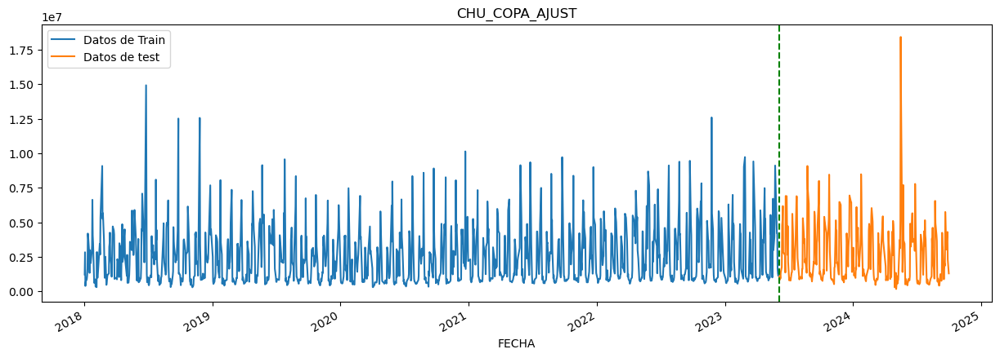

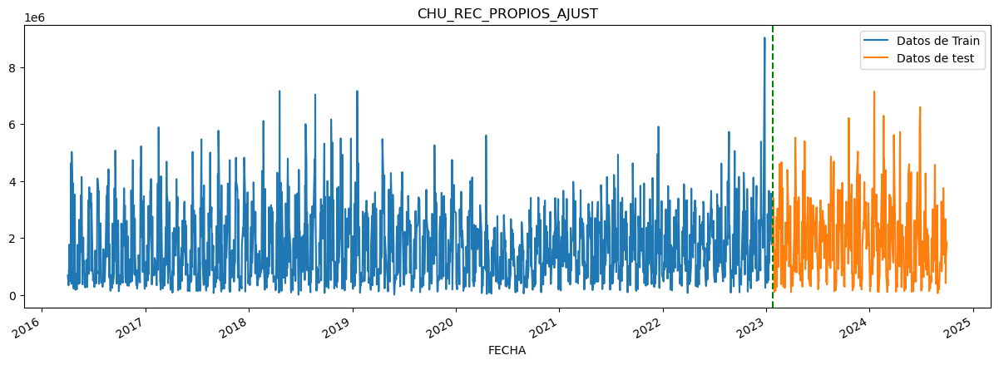

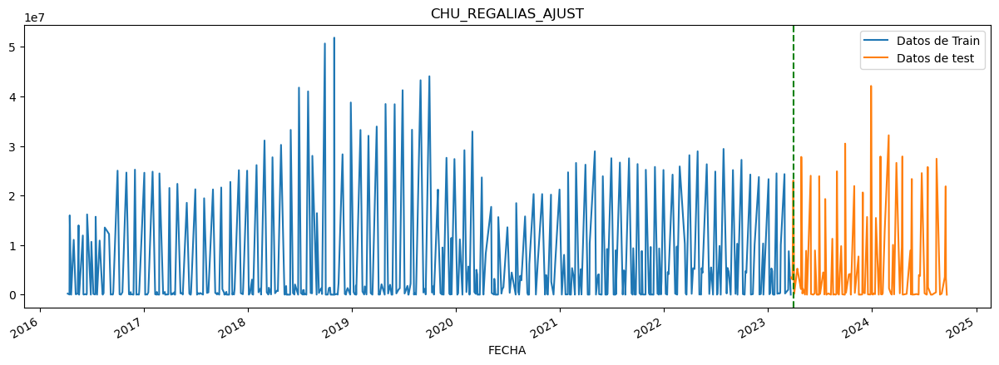

In [7]:
for i in range(len(dataframes)):
    # Separamos los datos en train y test
    fig, ax = plt.subplots(figsize=(15, 5))
    
    dataframes_train[i][titulos[i]].plot(ax=ax, label='Datos de Train', title=f'{titulos[i]}')
    dataframes_test[i][titulos[i]].plot(ax=ax, label='Datos de test')
    ax.axvline(f'{dataframes_test[i].index[i]}', color='green', ls='--')
    ax.legend(['Datos de Train', 'Datos de test'])
    plt.show()

In [8]:
FEATURES = ['dayofweek', 'quarter', 'month', 'year', 'dayofyear' , 'dayofmonth', 'weekofyear', 'lag1', 'lag2', 'lag3']
TARGET = 'CHU_COPA_AJUST'

In [9]:
X_train = dataframes_train[0][FEATURES]
y_train = dataframes_train[0][TARGET]

X_test = dataframes_test[0][FEATURES]
y_test = dataframes_test[0][TARGET]

In [10]:
import optuna
import lightgbm as lgb
import numpy as np
from sklearn.model_selection import TimeSeriesSplit
from sklearn.metrics import mean_squared_error



def objective(trial, df):
    param = {
        "n_estimators": trial.suggest_int("n_estimators", 500, 2000),
        "learning_rate": trial.suggest_loguniform("learning_rate", 0.001, 0.1),
        "max_depth": trial.suggest_int("max_depth", 3, 10),
        "num_leaves": trial.suggest_int("num_leaves", 20, 150),
        "min_child_samples": trial.suggest_int("min_child_samples", 10, 100),
        "subsample": trial.suggest_uniform("subsample", 0.5, 1.0),
        "colsample_bytree": trial.suggest_uniform("colsample_bytree", 0.5, 1.0),
        "reg_alpha": trial.suggest_loguniform("reg_alpha", 0.01, 1.0),
        "reg_lambda": trial.suggest_loguniform("reg_lambda", 0.01, 1.0),
        "random_state": 42,
    }

    test_size = 100
    tss = TimeSeriesSplit(n_splits=5, test_size=test_size, gap=10)
    scores = []

    for train_idx, val_idx in tss.split(df):
        train = df.iloc[train_idx]
        test = df.iloc[val_idx]

        FEATURES = ['dayofyear', 'dayofweek', 'quarter', 'month', 'year',
                    'lag1', 'lag2', 'lag3']
        TARGET = df.columns[0]

        # Verificar características y dropna
        assert all(feature in train.columns for feature in FEATURES), "Faltan columnas en train"
        assert all(feature in test.columns for feature in FEATURES), "Faltan columnas en test"

        X_train = train[FEATURES].dropna()
        y_train = train[TARGET].loc[X_train.index]
        X_test = test[FEATURES].dropna()
        y_test = test[TARGET].loc[X_test.index]

        if X_train.empty or X_test.empty:
            raise ValueError("X_train o X_test está vacío después de dropna")

        model = lgb.LGBMRegressor(**param, early_stopping_rounds=50)
        model.fit(
            X_train, y_train,
            eval_set=[(X_test, y_test)],
            eval_metric="rmse"
        )

        y_pred = model.predict(X_test)
        rmse = mean_squared_error(y_test, y_pred, squared=False)
        scores.append(rmse)

    return np.mean(scores)


In [11]:
# Ejecutar la optimización con Optuna
df = dataframes_train[0].copy() ### ACACAACACACACACACACA
study = optuna.create_study(direction="minimize")
study.optimize(lambda trial: objective(trial, df), n_trials=100)


copa_best_params = study.best_params
copa_rmse = study.best_value
# Imprimir los mejores parámetros y el mejor RMSE
print("Mejores parámetros para COPA:", study.best_params)
print("Mejor RMSE promedio para COPA:", study.best_value)

[I 2024-11-17 16:06:36,818] A new study created in memory with name: no-name-9f286dcb-98ef-4d7b-9ac9-8a52c8968793


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 49, number of used features: 0
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 2212306.251276
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more le

[I 2024-11-17 16:06:37,670] Trial 0 finished with value: 1632963.9475151887 and parameters: {'n_estimators': 585, 'learning_rate': 0.0034564827245278525, 'max_depth': 6, 'num_leaves': 23, 'min_child_samples': 39, 'subsample': 0.7402640054727891, 'colsample_bytree': 0.6906178757541843, 'reg_alpha': 0.5165613659490879, 'reg_lambda': 0.012626913295569841}. Best is trial 0 with value: 1632963.9475151887.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:06:38,026] Trial 1 finished with value: 1609451.448832258 and parameters: {'n_estimators': 1592, 'learning_rate': 0.026856833998848882, 'max_depth': 10, 'num_leaves': 129, 'min_child_samples': 55, 'subsample': 0.931698282427525, 'colsample_bytree': 0.5511729800908325, 'reg_alpha': 0.23970536517389857, 'reg_lambda': 0.033482440313163525}. Best is trial 1 with value: 1609451.448832258.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:06:38,335] Trial 2 finished with value: 1483408.137701594 and parameters: {'n_estimators': 1041, 'learning_rate': 0.04368371276843191, 'max_depth': 3, 'num_leaves': 50, 'min_child_samples': 16, 'subsample': 0.9088131384434373, 'colsample_bytree': 0.9920580141241149, 'reg_alpha': 0.7020234741678134, 'reg_lambda': 0.7113964949305074}. Best is trial 2 with value: 1483408.137701594.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000130 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 373, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 2546322.198391
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:06:40,680] Trial 3 finished with value: 1648388.9718849543 and parameters: {'n_estimators': 1798, 'learning_rate': 0.0010049446209834014, 'max_depth': 4, 'num_leaves': 127, 'min_child_samples': 14, 'subsample': 0.7590591689590978, 'colsample_bytree': 0.5474845827771838, 'reg_alpha': 0.012927684172400925, 'reg_lambda': 0.20458867158008825}. Best is trial 2 with value: 1483408.137701594.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 49, number of used features: 0
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 2212306.251276
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more le

[I 2024-11-17 16:06:40,894] Trial 4 finished with value: 1761399.4640903294 and parameters: {'n_estimators': 1337, 'learning_rate': 0.06508810934035152, 'max_depth': 5, 'num_leaves': 115, 'min_child_samples': 100, 'subsample': 0.704731204694187, 'colsample_bytree': 0.6831397421453753, 'reg_alpha': 0.8477427214411299, 'reg_lambda': 0.08966784273952393}. Best is trial 2 with value: 1483408.137701594.
[I 2024-11-17 16:06:41,079] Trial 5 finished with value: 1556766.9022277729 and parameters: {'n_estimators': 877, 'learning_rate': 0.08625476853562755, 'max_depth': 4, 'num_leaves': 109, 'min_child_samples': 39, 'subsample': 0.7941195310679807, 'colsample_bytree': 0.6428245614448767, 'reg_alpha': 0.010634512633458012, 'reg_lambda': 0.19191695620786006}. Best is trial 2 with value: 1483408.137701594.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:06:41,362] Trial 6 finished with value: 1486443.0586449266 and parameters: {'n_estimators': 1983, 'learning_rate': 0.04447212778207453, 'max_depth': 9, 'num_leaves': 85, 'min_child_samples': 20, 'subsample': 0.7890373238252166, 'colsample_bytree': 0.9354192817727035, 'reg_alpha': 0.46311790857753077, 'reg_lambda': 0.01541937762701232}. Best is trial 2 with value: 1483408.137701594.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:06:41,691] Trial 7 finished with value: 1629935.5346740957 and parameters: {'n_estimators': 614, 'learning_rate': 0.020069201033770124, 'max_depth': 9, 'num_leaves': 44, 'min_child_samples': 57, 'subsample': 0.9111421772080939, 'colsample_bytree': 0.9462114589955064, 'reg_alpha': 0.18539509500739615, 'reg_lambda': 0.08566931782262069}. Best is trial 2 with value: 1483408.137701594.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:06:42,194] Trial 8 finished with value: 1618997.7405815918 and parameters: {'n_estimators': 559, 'learning_rate': 0.013338630898530998, 'max_depth': 7, 'num_leaves': 73, 'min_child_samples': 52, 'subsample': 0.8390716028640817, 'colsample_bytree': 0.8311405711918456, 'reg_alpha': 0.015108521260061014, 'reg_lambda': 0.013378295569806676}. Best is trial 2 with value: 1483408.137701594.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:06:42,608] Trial 9 finished with value: 1769364.6595835022 and parameters: {'n_estimators': 987, 'learning_rate': 0.003418683040226411, 'max_depth': 3, 'num_leaves': 120, 'min_child_samples': 95, 'subsample': 0.5961068854989162, 'colsample_bytree': 0.9936873117640237, 'reg_alpha': 0.1609235748322754, 'reg_lambda': 0.5891622673706223}. Best is trial 2 with value: 1483408.137701594.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:06:43,140] Trial 10 finished with value: 1732860.804132135 and parameters: {'n_estimators': 1207, 'learning_rate': 0.007540392174106848, 'max_depth': 7, 'num_leaves': 51, 'min_child_samples': 78, 'subsample': 0.9862481303816985, 'colsample_bytree': 0.8363136108344577, 'reg_alpha': 0.043427781465444786, 'reg_lambda': 0.8168367260028151}. Best is trial 2 with value: 1483408.137701594.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:06:43,659] Trial 11 finished with value: 1484574.163662587 and parameters: {'n_estimators': 1988, 'learning_rate': 0.040081135504045004, 'max_depth': 9, 'num_leaves': 85, 'min_child_samples': 10, 'subsample': 0.8692781100486591, 'colsample_bytree': 0.8977068309908978, 'reg_alpha': 0.4406541064883466, 'reg_lambda': 0.03612897427903692}. Best is trial 2 with value: 1483408.137701594.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000092 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 400
[LightGBM] [Info] Number of data points in the train set: 283, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 2439754.059187
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:06:43,956] Trial 12 finished with value: 1557491.5986377294 and parameters: {'n_estimators': 1431, 'learning_rate': 0.03539639120943133, 'max_depth': 8, 'num_leaves': 60, 'min_child_samples': 25, 'subsample': 0.8880231118074757, 'colsample_bytree': 0.8222605714733726, 'reg_alpha': 0.9283739305704586, 'reg_lambda': 0.03549262008342891}. Best is trial 2 with value: 1483408.137701594.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 49, number of used features: 0
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 2212306.251276
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more le

[I 2024-11-17 16:06:44,192] Trial 13 finished with value: 1483476.0949498776 and parameters: {'n_estimators': 1069, 'learning_rate': 0.09089507538116037, 'max_depth': 6, 'num_leaves': 95, 'min_child_samples': 10, 'subsample': 0.9798230810337935, 'colsample_bytree': 0.9069017792985127, 'reg_alpha': 0.07311953787619686, 'reg_lambda': 0.33998378145201336}. Best is trial 2 with value: 1483408.137701594.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000024 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 82
[LightGBM] [Info] Number of data points in the train set: 49, number of used features: 6
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 2212306.251276
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No furth

[I 2024-11-17 16:06:44,557] Trial 14 finished with value: 1571614.921999698 and parameters: {'n_estimators': 1039, 'learning_rate': 0.09875941807994872, 'max_depth': 3, 'num_leaves': 99, 'min_child_samples': 31, 'subsample': 0.9971928219156284, 'colsample_bytree': 0.9966846797117502, 'reg_alpha': 0.048667325783894225, 'reg_lambda': 0.422131764743407}. Best is trial 2 with value: 1483408.137701594.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:06:44,836] Trial 15 finished with value: 1557534.848369774 and parameters: {'n_estimators': 807, 'learning_rate': 0.06097489856220044, 'max_depth': 5, 'num_leaves': 29, 'min_child_samples': 26, 'subsample': 0.5149577118081077, 'colsample_bytree': 0.8851331180771492, 'reg_alpha': 0.053520888957692164, 'reg_lambda': 0.29092164305716084}. Best is trial 2 with value: 1483408.137701594.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:06:45,191] Trial 16 finished with value: 1748160.4201304899 and parameters: {'n_estimators': 1167, 'learning_rate': 0.016207385597913893, 'max_depth': 6, 'num_leaves': 148, 'min_child_samples': 71, 'subsample': 0.9497871928023884, 'colsample_bytree': 0.7586558052779735, 'reg_alpha': 0.08711974148859665, 'reg_lambda': 0.9568904508013634}. Best is trial 2 with value: 1483408.137701594.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 49, number of used features: 0
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 2212306.251276
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more le

[I 2024-11-17 16:06:46,239] Trial 17 finished with value: 1560752.640812106 and parameters: {'n_estimators': 1512, 'learning_rate': 0.007331750411721863, 'max_depth': 5, 'num_leaves': 72, 'min_child_samples': 36, 'subsample': 0.6772213611317235, 'colsample_bytree': 0.9206454922383395, 'reg_alpha': 0.02406395954146593, 'reg_lambda': 0.4074104950902131}. Best is trial 2 with value: 1483408.137701594.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:06:46,541] Trial 18 finished with value: 1461899.049398819 and parameters: {'n_estimators': 796, 'learning_rate': 0.0634280021974276, 'max_depth': 4, 'num_leaves': 91, 'min_child_samples': 10, 'subsample': 0.8292870947602153, 'colsample_bytree': 0.774231522629009, 'reg_alpha': 0.09650147029736371, 'reg_lambda': 0.1578175314489746}. Best is trial 18 with value: 1461899.049398819.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000034 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 308
[LightGBM] [Info] Number of data points in the train set: 209, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 2369900.034091
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

[I 2024-11-17 16:06:47,168] Trial 19 finished with value: 1565101.8858807243 and parameters: {'n_estimators': 760, 'learning_rate': 0.02522601501158348, 'max_depth': 4, 'num_leaves': 38, 'min_child_samples': 47, 'subsample': 0.8363977585548691, 'colsample_bytree': 0.76689044379073, 'reg_alpha': 0.14114380552610076, 'reg_lambda': 0.12684270231035966}. Best is trial 18 with value: 1461899.049398819.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000054 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 400
[LightGBM] [Info] Number of data points in the train set: 283, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 2439754.059187
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:06:47,981] Trial 20 finished with value: 1462953.1454072199 and parameters: {'n_estimators': 721, 'learning_rate': 0.05130989232431297, 'max_depth': 3, 'num_leaves': 61, 'min_child_samples': 20, 'subsample': 0.6274509438317057, 'colsample_bytree': 0.5919884743989734, 'reg_alpha': 0.2829871135984606, 'reg_lambda': 0.05740559596515858}. Best is trial 18 with value: 1461899.049398819.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:06:48,570] Trial 21 finished with value: 1445001.3003794544 and parameters: {'n_estimators': 738, 'learning_rate': 0.05204516023967789, 'max_depth': 3, 'num_leaves': 61, 'min_child_samples': 18, 'subsample': 0.6304056465559393, 'colsample_bytree': 0.5016141849258937, 'reg_alpha': 0.28554734414942873, 'reg_lambda': 0.05640263528401383}. Best is trial 21 with value: 1445001.3003794544.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 400
[LightGBM] [Info] Number of data points in the train set: 283, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 2439754.059187
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:06:49,482] Trial 22 finished with value: 1464906.598472735 and parameters: {'n_estimators': 720, 'learning_rate': 0.05714956803715126, 'max_depth': 3, 'num_leaves': 67, 'min_child_samples': 23, 'subsample': 0.6305914628210298, 'colsample_bytree': 0.5003478483999427, 'reg_alpha': 0.2849808872238652, 'reg_lambda': 0.057472602901496195}. Best is trial 21 with value: 1445001.3003794544.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[63]	valid_0's rmse: 1.46246e+06	valid_0's l2: 2.1388e+12
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will

[I 2024-11-17 16:06:50,732] Trial 23 finished with value: 1564571.5762635258 and parameters: {'n_estimators': 904, 'learning_rate': 0.02845372094868382, 'max_depth': 4, 'num_leaves': 63, 'min_child_samples': 30, 'subsample': 0.5662615195966648, 'colsample_bytree': 0.6092451530650116, 'reg_alpha': 0.29116580274926857, 'reg_lambda': 0.06383671437739095}. Best is trial 21 with value: 1445001.3003794544.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:06:51,658] Trial 24 finished with value: 1457909.9448659972 and parameters: {'n_estimators': 687, 'learning_rate': 0.010683531808369994, 'max_depth': 3, 'num_leaves': 81, 'min_child_samples': 18, 'subsample': 0.6604412363839166, 'colsample_bytree': 0.5021311889180584, 'reg_alpha': 0.1205961330982209, 'reg_lambda': 0.14382749398779685}. Best is trial 21 with value: 1445001.3003794544.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 49, number of used features: 0
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 2212306.251276
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more le

[I 2024-11-17 16:06:52,194] Trial 25 finished with value: 1836484.3448398025 and parameters: {'n_estimators': 511, 'learning_rate': 0.0037273144710114553, 'max_depth': 4, 'num_leaves': 96, 'min_child_samples': 66, 'subsample': 0.6887507781667564, 'colsample_bytree': 0.516487571583822, 'reg_alpha': 0.11777216838374832, 'reg_lambda': 0.13612400351952517}. Best is trial 21 with value: 1445001.3003794544.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:06:53,827] Trial 26 finished with value: 1637354.6111878597 and parameters: {'n_estimators': 894, 'learning_rate': 0.0012949220140286686, 'max_depth': 5, 'num_leaves': 87, 'min_child_samples': 15, 'subsample': 0.6396450782099208, 'colsample_bytree': 0.7148188557180418, 'reg_alpha': 0.032152302397611285, 'reg_lambda': 0.18952430454345406}. Best is trial 21 with value: 1445001.3003794544.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:06:54,281] Trial 27 finished with value: 1574474.247733471 and parameters: {'n_estimators': 665, 'learning_rate': 0.010874235839819293, 'max_depth': 3, 'num_leaves': 74, 'min_child_samples': 45, 'subsample': 0.731115771154012, 'colsample_bytree': 0.5882332344922446, 'reg_alpha': 0.09837287222356386, 'reg_lambda': 0.1249382846018677}. Best is trial 21 with value: 1445001.3003794544.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000042 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 400
[LightGBM] [Info] Number of data points in the train set: 283, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 2439754.059187
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:06:55,118] Trial 28 finished with value: 1562777.1480367635 and parameters: {'n_estimators': 836, 'learning_rate': 0.005442500586807774, 'max_depth': 4, 'num_leaves': 102, 'min_child_samples': 35, 'subsample': 0.5439475378917802, 'colsample_bytree': 0.6486579107353853, 'reg_alpha': 0.06333288714041438, 'reg_lambda': 0.07220788837362362}. Best is trial 21 with value: 1445001.3003794544.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 49, number of used features: 0
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 2212306.251276
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more le

[I 2024-11-17 16:06:55,959] Trial 29 finished with value: 1678823.3983249548 and parameters: {'n_estimators': 643, 'learning_rate': 0.0021045403025287688, 'max_depth': 5, 'num_leaves': 79, 'min_child_samples': 42, 'subsample': 0.6628904845068538, 'colsample_bytree': 0.7892326207159963, 'reg_alpha': 0.20214780528408974, 'reg_lambda': 0.02054235336414534}. Best is trial 21 with value: 1445001.3003794544.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:06:56,269] Trial 30 finished with value: 1559429.6606194414 and parameters: {'n_estimators': 1137, 'learning_rate': 0.07216071852616461, 'max_depth': 3, 'num_leaves': 28, 'min_child_samples': 30, 'subsample': 0.7260780150822705, 'colsample_bytree': 0.703442312743453, 'reg_alpha': 0.12755535134086374, 'reg_lambda': 0.043392126956626274}. Best is trial 21 with value: 1445001.3003794544.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000050 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 195
[LightGBM] [Info] Number of data points in the train set: 129, number of used features: 7
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 2287573.595930
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] N

[I 2024-11-17 16:06:57,084] Trial 31 finished with value: 1444581.0948436025 and parameters: {'n_estimators': 713, 'learning_rate': 0.019591513197996426, 'max_depth': 3, 'num_leaves': 62, 'min_child_samples': 19, 'subsample': 0.6232186706998313, 'colsample_bytree': 0.5594373575847704, 'reg_alpha': 0.3521983053770483, 'reg_lambda': 0.024611989544183144}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:06:57,801] Trial 32 finished with value: 1491273.5091566606 and parameters: {'n_estimators': 531, 'learning_rate': 0.017176174317032868, 'max_depth': 4, 'num_leaves': 52, 'min_child_samples': 16, 'subsample': 0.5907492189244683, 'colsample_bytree': 0.5421368603042477, 'reg_alpha': 0.3611842583326027, 'reg_lambda': 0.01834903764574695}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:06:58,389] Trial 33 finished with value: 1447781.2370350282 and parameters: {'n_estimators': 958, 'learning_rate': 0.03044920008550048, 'max_depth': 3, 'num_leaves': 78, 'min_child_samples': 20, 'subsample': 0.5999948762946976, 'colsample_bytree': 0.5276783115004945, 'reg_alpha': 0.521621813552693, 'reg_lambda': 0.0224100152204041}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:06:58,767] Trial 34 finished with value: 1454028.8036777955 and parameters: {'n_estimators': 919, 'learning_rate': 0.03029315808161436, 'max_depth': 3, 'num_leaves': 57, 'min_child_samples': 18, 'subsample': 0.604071547128027, 'colsample_bytree': 0.566401200931863, 'reg_alpha': 0.5352460201193984, 'reg_lambda': 0.024743347119008382}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 49, number of used features: 0
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 2212306.251276
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more le

[I 2024-11-17 16:06:59,238] Trial 35 finished with value: 1546908.4888643108 and parameters: {'n_estimators': 963, 'learning_rate': 0.030136519944015627, 'max_depth': 3, 'num_leaves': 40, 'min_child_samples': 26, 'subsample': 0.5997977767740751, 'colsample_bytree': 0.5681866436108401, 'reg_alpha': 0.6573937149657373, 'reg_lambda': 0.025468417569361274}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:06:59,833] Trial 36 finished with value: 1559380.499185127 and parameters: {'n_estimators': 1319, 'learning_rate': 0.021290422191718086, 'max_depth': 3, 'num_leaves': 54, 'min_child_samples': 34, 'subsample': 0.5194659408742831, 'colsample_bytree': 0.5312906514606167, 'reg_alpha': 0.6342659235052649, 'reg_lambda': 0.022640046669403172}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000091 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 373, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 2546322.198391
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:07:00,373] Trial 37 finished with value: 1475758.0961562034 and parameters: {'n_estimators': 969, 'learning_rate': 0.03399979198290596, 'max_depth': 4, 'num_leaves': 68, 'min_child_samples': 22, 'subsample': 0.5551396712767069, 'colsample_bytree': 0.6238507372725639, 'reg_alpha': 0.531065583830929, 'reg_lambda': 0.010819559759441566}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[178]	valid_0's rmse: 1.24418e+06	valid_0's l2: 1.54798e+12
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000065 s

[I 2024-11-17 16:07:01,050] Trial 38 finished with value: 1476214.7643125693 and parameters: {'n_estimators': 1087, 'learning_rate': 0.024297856109976583, 'max_depth': 5, 'num_leaves': 44, 'min_child_samples': 16, 'subsample': 0.5813584166387983, 'colsample_bytree': 0.5660759753427227, 'reg_alpha': 0.3768104626275363, 'reg_lambda': 0.028398296972469355}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:07:01,532] Trial 39 finished with value: 1562771.4441285527 and parameters: {'n_estimators': 1267, 'learning_rate': 0.04568564719855896, 'max_depth': 10, 'num_leaves': 55, 'min_child_samples': 28, 'subsample': 0.6151926595116552, 'colsample_bytree': 0.668075008022049, 'reg_alpha': 0.2189646070533201, 'reg_lambda': 0.04192186488547333}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:07:02,365] Trial 40 finished with value: 1559810.4242103638 and parameters: {'n_estimators': 1764, 'learning_rate': 0.013576543815792591, 'max_depth': 3, 'num_leaves': 77, 'min_child_samples': 39, 'subsample': 0.7119215238581095, 'colsample_bytree': 0.5702160088503974, 'reg_alpha': 0.7347871876314672, 'reg_lambda': 0.01447951512125476}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:07:03,381] Trial 41 finished with value: 1455487.6170769734 and parameters: {'n_estimators': 672, 'learning_rate': 0.010277815939754964, 'max_depth': 3, 'num_leaves': 79, 'min_child_samples': 19, 'subsample': 0.6587739793616698, 'colsample_bytree': 0.5026903253282808, 'reg_alpha': 0.5099633908489932, 'reg_lambda': 0.017542555181438307}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:07:04,078] Trial 42 finished with value: 1462717.176179038 and parameters: {'n_estimators': 863, 'learning_rate': 0.01896987768870616, 'max_depth': 4, 'num_leaves': 69, 'min_child_samples': 21, 'subsample': 0.6461369216541186, 'colsample_bytree': 0.538292779457932, 'reg_alpha': 0.5469169237529513, 'reg_lambda': 0.017858791199058994}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:07:04,962] Trial 43 finished with value: 1498265.597037635 and parameters: {'n_estimators': 603, 'learning_rate': 0.008338346795789667, 'max_depth': 3, 'num_leaves': 62, 'min_child_samples': 14, 'subsample': 0.6132645265898445, 'colsample_bytree': 0.5258840085295627, 'reg_alpha': 0.35320576230959944, 'reg_lambda': 0.010560009871814366}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:07:06,040] Trial 44 finished with value: 1746018.6199411787 and parameters: {'n_estimators': 773, 'learning_rate': 0.014759992360688973, 'max_depth': 3, 'num_leaves': 46, 'min_child_samples': 87, 'subsample': 0.5363509590603995, 'colsample_bytree': 0.5563792636279062, 'reg_alpha': 0.9783974235516375, 'reg_lambda': 0.028289034795700482}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:07:06,647] Trial 45 finished with value: 1472514.332143936 and parameters: {'n_estimators': 585, 'learning_rate': 0.037432958841086446, 'max_depth': 4, 'num_leaves': 107, 'min_child_samples': 13, 'subsample': 0.7530504807995845, 'colsample_bytree': 0.5967079626732474, 'reg_alpha': 0.4700913014907425, 'reg_lambda': 0.01635919498292277}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:07:07,448] Trial 46 finished with value: 1470318.518998289 and parameters: {'n_estimators': 927, 'learning_rate': 0.021013668997075175, 'max_depth': 3, 'num_leaves': 57, 'min_child_samples': 21, 'subsample': 0.6856437272021404, 'colsample_bytree': 0.6231116350507702, 'reg_alpha': 0.7260754975082857, 'reg_lambda': 0.04355389584981821}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000022 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 400
[LightGBM] [Info] Number of data points in the train set: 283, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 2439754.059187
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits

[I 2024-11-17 16:07:08,214] Trial 47 finished with value: 1468834.6628820165 and parameters: {'n_estimators': 726, 'learning_rate': 0.030491283746860037, 'max_depth': 8, 'num_leaves': 85, 'min_child_samples': 18, 'subsample': 0.5701855710488707, 'colsample_bytree': 0.5178566592356041, 'reg_alpha': 0.4132845128926588, 'reg_lambda': 0.03085168557543084}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000051 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 400
[LightGBM] [Info] Number of data points in the train set: 283, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 2439754.059187
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:07:09,267] Trial 48 finished with value: 1607604.2033936512 and parameters: {'n_estimators': 1023, 'learning_rate': 0.04572983134943482, 'max_depth': 4, 'num_leaves': 67, 'min_child_samples': 57, 'subsample': 0.7786745309554025, 'colsample_bytree': 0.554060541468914, 'reg_alpha': 0.24875563932235525, 'reg_lambda': 0.021027076323247875}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:07:09,778] Trial 49 finished with value: 1460280.406026921 and parameters: {'n_estimators': 827, 'learning_rate': 0.07606619197812325, 'max_depth': 3, 'num_leaves': 20, 'min_child_samples': 24, 'subsample': 0.6608840068623277, 'colsample_bytree': 0.5009306161174982, 'reg_alpha': 0.5554900175091871, 'reg_lambda': 0.013476133701958284}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000719 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 308
[LightGBM] [Info] Number of data points in the train set: 209, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 2369900.034091
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

[I 2024-11-17 16:07:10,894] Trial 50 finished with value: 1464562.678035096 and parameters: {'n_estimators': 648, 'learning_rate': 0.012520882648695882, 'max_depth': 7, 'num_leaves': 47, 'min_child_samples': 11, 'subsample': 0.6037134588013513, 'colsample_bytree': 0.5843052537506448, 'reg_alpha': 0.17880141485040002, 'reg_lambda': 0.035745017966280115}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:07:11,773] Trial 51 finished with value: 1465102.6872906548 and parameters: {'n_estimators': 713, 'learning_rate': 0.009027174033955714, 'max_depth': 3, 'num_leaves': 79, 'min_child_samples': 18, 'subsample': 0.6510618742783869, 'colsample_bytree': 0.5021550564803525, 'reg_alpha': 0.3332188776831972, 'reg_lambda': 0.08962847015647343}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:07:12,610] Trial 52 finished with value: 1506550.440832755 and parameters: {'n_estimators': 668, 'learning_rate': 0.006226274496979973, 'max_depth': 3, 'num_leaves': 79, 'min_child_samples': 18, 'subsample': 0.6987424235399221, 'colsample_bytree': 0.5357383070366931, 'reg_alpha': 0.4459857552527435, 'reg_lambda': 0.02457018516707378}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:07:13,394] Trial 53 finished with value: 1642969.423023982 and parameters: {'n_estimators': 575, 'learning_rate': 0.004635340353692492, 'max_depth': 3, 'num_leaves': 88, 'min_child_samples': 27, 'subsample': 0.672983158046955, 'colsample_bytree': 0.5192410938830732, 'reg_alpha': 0.763414879002798, 'reg_lambda': 0.23568946582975028}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 49, number of used features: 0
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 2212306.251276
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more le

[I 2024-11-17 16:07:15,078] Trial 54 finished with value: 1569456.5229167223 and parameters: {'n_estimators': 797, 'learning_rate': 0.010783566147926875, 'max_depth': 4, 'num_leaves': 73, 'min_child_samples': 33, 'subsample': 0.6239890691535183, 'colsample_bytree': 0.5495103507472762, 'reg_alpha': 0.5904235549593924, 'reg_lambda': 0.11231754443766506}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:07:15,573] Trial 55 finished with value: 1463084.3606438413 and parameters: {'n_estimators': 683, 'learning_rate': 0.023049448250167987, 'max_depth': 3, 'num_leaves': 59, 'min_child_samples': 24, 'subsample': 0.5811331634132952, 'colsample_bytree': 0.516377015106166, 'reg_alpha': 0.24856118498469984, 'reg_lambda': 0.07954872549257826}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000036 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 400
[LightGBM] [Info] Number of data points in the train set: 283, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 2439754.059187
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:07:16,486] Trial 56 finished with value: 1478948.419218268 and parameters: {'n_estimators': 759, 'learning_rate': 0.016538474692650768, 'max_depth': 4, 'num_leaves': 92, 'min_child_samples': 13, 'subsample': 0.6398479816314512, 'colsample_bytree': 0.5754337969622206, 'reg_alpha': 0.15296770303297297, 'reg_lambda': 0.05023283770609134}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:07:17,138] Trial 57 finished with value: 1605742.9813780664 and parameters: {'n_estimators': 864, 'learning_rate': 0.011803709783673892, 'max_depth': 3, 'num_leaves': 82, 'min_child_samples': 51, 'subsample': 0.7097570488270633, 'colsample_bytree': 0.6033805851655726, 'reg_alpha': 0.31620242339244065, 'reg_lambda': 0.019882978254510297}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000080 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 373, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 2546322.198391
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:07:18,092] Trial 58 finished with value: 1465964.445578625 and parameters: {'n_estimators': 914, 'learning_rate': 0.009608676533283766, 'max_depth': 3, 'num_leaves': 65, 'min_child_samples': 19, 'subsample': 0.6106608262397513, 'colsample_bytree': 0.7384821434279003, 'reg_alpha': 0.8138835454265061, 'reg_lambda': 0.012314414649894707}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:07:18,716] Trial 59 finished with value: 1556775.2307479219 and parameters: {'n_estimators': 613, 'learning_rate': 0.05105731712789263, 'max_depth': 5, 'num_leaves': 141, 'min_child_samples': 30, 'subsample': 0.5030465359458507, 'colsample_bytree': 0.500586451212491, 'reg_alpha': 0.4856454984078828, 'reg_lambda': 0.016166141507873235}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:07:19,113] Trial 60 finished with value: 1455777.912379652 and parameters: {'n_estimators': 519, 'learning_rate': 0.03376513013519619, 'max_depth': 4, 'num_leaves': 71, 'min_child_samples': 12, 'subsample': 0.6626426870140867, 'colsample_bytree': 0.6209598499654903, 'reg_alpha': 0.4069933986806612, 'reg_lambda': 0.031373374393057346}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000042 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 373, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 2546322.198391
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:07:19,739] Trial 61 finished with value: 1469514.7548053865 and parameters: {'n_estimators': 548, 'learning_rate': 0.035118614379788755, 'max_depth': 3, 'num_leaves': 71, 'min_child_samples': 12, 'subsample': 0.6726726960462467, 'colsample_bytree': 0.5496065408268529, 'reg_alpha': 0.4061451800466066, 'reg_lambda': 0.03313738452610071}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:07:20,270] Trial 62 finished with value: 1466925.5326649984 and parameters: {'n_estimators': 519, 'learning_rate': 0.026576684266753324, 'max_depth': 4, 'num_leaves': 82, 'min_child_samples': 16, 'subsample': 0.6570647721034336, 'colsample_bytree': 0.6193452726260171, 'reg_alpha': 0.254077514830335, 'reg_lambda': 0.025741788951298746}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000096 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 400
[LightGBM] [Info] Number of data points in the train set: 283, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 2439754.059187
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:07:21,075] Trial 63 finished with value: 1486733.5395003364 and parameters: {'n_estimators': 501, 'learning_rate': 0.007123038599917328, 'max_depth': 3, 'num_leaves': 75, 'min_child_samples': 10, 'subsample': 0.6276444275413672, 'colsample_bytree': 0.9674281310835013, 'reg_alpha': 0.4717740271294507, 'reg_lambda': 0.05359947788427256}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:07:21,510] Trial 64 finished with value: 1470524.429137624 and parameters: {'n_estimators': 702, 'learning_rate': 0.03924672253835472, 'max_depth': 4, 'num_leaves': 64, 'min_child_samples': 23, 'subsample': 0.5903793661266913, 'colsample_bytree': 0.524785530192234, 'reg_alpha': 0.18568181675378223, 'reg_lambda': 0.06826708727831815}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000040 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 373, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 2546322.198391
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:07:22,106] Trial 65 finished with value: 1460846.0230913616 and parameters: {'n_estimators': 622, 'learning_rate': 0.018761441420343854, 'max_depth': 3, 'num_leaves': 60, 'min_child_samples': 19, 'subsample': 0.5645650908243213, 'colsample_bytree': 0.6447412866321358, 'reg_alpha': 0.6159127904421413, 'reg_lambda': 0.03765202911847846}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:07:22,743] Trial 66 finished with value: 1550559.864307336 and parameters: {'n_estimators': 740, 'learning_rate': 0.055407862426228145, 'max_depth': 4, 'num_leaves': 49, 'min_child_samples': 27, 'subsample': 0.6923490028554362, 'colsample_bytree': 0.5594415714568944, 'reg_alpha': 0.07973328176823988, 'reg_lambda': 0.021524044997825575}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:07:23,255] Trial 67 finished with value: 1464683.4829156802 and parameters: {'n_estimators': 824, 'learning_rate': 0.029586890962786477, 'max_depth': 3, 'num_leaves': 91, 'min_child_samples': 15, 'subsample': 0.6430747629431229, 'colsample_bytree': 0.5826019076348494, 'reg_alpha': 0.29969422392449646, 'reg_lambda': 0.10040948702544364}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000269 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 400
[LightGBM] [Info] Number of data points in the train set: 283, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 2439754.059187
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:07:23,879] Trial 68 finished with value: 1446100.1013171237 and parameters: {'n_estimators': 998, 'learning_rate': 0.04296070102251775, 'max_depth': 3, 'num_leaves': 35, 'min_child_samples': 21, 'subsample': 0.6273595204593183, 'colsample_bytree': 0.5381020308285114, 'reg_alpha': 0.3912592363355486, 'reg_lambda': 0.04719382320112521}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:07:24,481] Trial 69 finished with value: 1470876.8138959215 and parameters: {'n_estimators': 1094, 'learning_rate': 0.04329599139782122, 'max_depth': 6, 'num_leaves': 32, 'min_child_samples': 22, 'subsample': 0.6236056242401253, 'colsample_bytree': 0.6119021019719665, 'reg_alpha': 0.39622132157124984, 'reg_lambda': 0.04987241233132868}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000098 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 373, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 2546322.198391
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:07:24,975] Trial 70 finished with value: 1737655.7166404887 and parameters: {'n_estimators': 980, 'learning_rate': 0.05024336846698664, 'max_depth': 3, 'num_leaves': 37, 'min_child_samples': 76, 'subsample': 0.5540041411145775, 'colsample_bytree': 0.534134801668087, 'reg_alpha': 0.33084828309396613, 'reg_lambda': 0.029981422053055835}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013155 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 400
[LightGBM] [Info] Number of data points in the train set: 283, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 2439754.059187
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] N

[I 2024-11-17 16:07:25,518] Trial 71 finished with value: 1703178.7052486632 and parameters: {'n_estimators': 1023, 'learning_rate': 0.06769400484076386, 'max_depth': 3, 'num_leaves': 82, 'min_child_samples': 65, 'subsample': 0.664771717932944, 'colsample_bytree': 0.5114841630786603, 'reg_alpha': 0.5042605045816845, 'reg_lambda': 0.14961021681173528}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 400
[LightGBM] [Info] Number of data points in the train set: 283, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 2439754.059187
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:07:26,192] Trial 72 finished with value: 1470150.4472443191 and parameters: {'n_estimators': 1162, 'learning_rate': 0.03206531244285792, 'max_depth': 4, 'num_leaves': 71, 'min_child_samples': 17, 'subsample': 0.598373172222019, 'colsample_bytree': 0.5364226516859036, 'reg_alpha': 0.021891993958491507, 'reg_lambda': 0.0412806346110972}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000044 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 400
[LightGBM] [Info] Number of data points in the train set: 283, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 2439754.059187
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:07:26,778] Trial 73 finished with value: 1471889.5778335533 and parameters: {'n_estimators': 1425, 'learning_rate': 0.025558465885551145, 'max_depth': 3, 'num_leaves': 52, 'min_child_samples': 14, 'subsample': 0.6340974209983481, 'colsample_bytree': 0.5678305995447119, 'reg_alpha': 0.11648420305373289, 'reg_lambda': 0.024126137364873426}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 373, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 2546322.198391
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:07:27,969] Trial 74 finished with value: 1451404.0333386115 and parameters: {'n_estimators': 780, 'learning_rate': 0.015053767843541458, 'max_depth': 3, 'num_leaves': 75, 'min_child_samples': 20, 'subsample': 0.7381363505284135, 'colsample_bytree': 0.5464266968050729, 'reg_alpha': 0.21770952193538284, 'reg_lambda': 0.17058509303525032}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:07:28,789] Trial 75 finished with value: 1562731.2507963495 and parameters: {'n_estimators': 924, 'learning_rate': 0.014730867284301586, 'max_depth': 4, 'num_leaves': 76, 'min_child_samples': 32, 'subsample': 0.8055095876279429, 'colsample_bytree': 0.5433767883870516, 'reg_alpha': 0.27581600644582116, 'reg_lambda': 0.01806391897950295}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:07:29,271] Trial 76 finished with value: 1541120.5051872935 and parameters: {'n_estimators': 782, 'learning_rate': 0.08267306698234511, 'max_depth': 3, 'num_leaves': 42, 'min_child_samples': 25, 'subsample': 0.8634178932755037, 'colsample_bytree': 0.634526633474452, 'reg_alpha': 0.21880262435504602, 'reg_lambda': 0.17921988295163083}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 49, number of used features: 0
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 2212306.251276
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more le

[I 2024-11-17 16:07:29,869] Trial 77 finished with value: 1555619.7097923704 and parameters: {'n_estimators': 875, 'learning_rate': 0.02212918276524967, 'max_depth': 3, 'num_leaves': 57, 'min_child_samples': 29, 'subsample': 0.724474445627783, 'colsample_bytree': 0.6687907548453256, 'reg_alpha': 0.3693341373556305, 'reg_lambda': 0.02686774873621852}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 400
[LightGBM] [Info] Number of data points in the train set: 283, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 2439754.059187
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:07:30,602] Trial 78 finished with value: 1466952.550410365 and parameters: {'n_estimators': 1892, 'learning_rate': 0.018567108272616612, 'max_depth': 3, 'num_leaves': 33, 'min_child_samples': 20, 'subsample': 0.5815987332950483, 'colsample_bytree': 0.5742401034115477, 'reg_alpha': 0.8731967863876815, 'reg_lambda': 0.22834698918029203}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000099 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 400
[LightGBM] [Info] Number of data points in the train set: 283, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 2439754.059187
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:07:31,137] Trial 79 finished with value: 1466505.5610694091 and parameters: {'n_estimators': 850, 'learning_rate': 0.058485928489816784, 'max_depth': 4, 'num_leaves': 67, 'min_child_samples': 10, 'subsample': 0.7689139581765446, 'colsample_bytree': 0.594991709831727, 'reg_alpha': 0.673934912376396, 'reg_lambda': 0.033583185452712966}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:07:31,773] Trial 80 finished with value: 1447863.8014019902 and parameters: {'n_estimators': 961, 'learning_rate': 0.04135688770959241, 'max_depth': 3, 'num_leaves': 64, 'min_child_samples': 21, 'subsample': 0.680958042573807, 'colsample_bytree': 0.5270571802343479, 'reg_alpha': 0.42232809977499985, 'reg_lambda': 0.04650592176464437}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000852 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 77
[LightGBM] [Info] Number of data points in the train set: 49, number of used features: 5
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 2212306.251276
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No furth

[I 2024-11-17 16:07:32,770] Trial 81 finished with value: 1450331.5789717024 and parameters: {'n_estimators': 1048, 'learning_rate': 0.04111641425937556, 'max_depth': 3, 'num_leaves': 63, 'min_child_samples': 21, 'subsample': 0.7416481208209665, 'colsample_bytree': 0.5576792633994495, 'reg_alpha': 0.5326769629644499, 'reg_lambda': 0.06415609288878955}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:07:33,296] Trial 82 finished with value: 1556124.0016313873 and parameters: {'n_estimators': 946, 'learning_rate': 0.04065612483239353, 'max_depth': 3, 'num_leaves': 63, 'min_child_samples': 36, 'subsample': 0.7416107933576045, 'colsample_bytree': 0.8503677182471931, 'reg_alpha': 0.5562334245575266, 'reg_lambda': 0.06006784326221323}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:07:33,999] Trial 83 finished with value: 1449839.6832432698 and parameters: {'n_estimators': 1061, 'learning_rate': 0.027441443074898653, 'max_depth': 3, 'num_leaves': 59, 'min_child_samples': 21, 'subsample': 0.7180452321563844, 'colsample_bytree': 0.5294102611911647, 'reg_alpha': 0.4510016578605782, 'reg_lambda': 0.07237327797692725}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:07:34,565] Trial 84 finished with value: 1450765.3017217708 and parameters: {'n_estimators': 1010, 'learning_rate': 0.03751285268988733, 'max_depth': 3, 'num_leaves': 55, 'min_child_samples': 22, 'subsample': 0.7383007475216005, 'colsample_bytree': 0.527656732933567, 'reg_alpha': 0.4556820656436892, 'reg_lambda': 0.07527335617440037}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:07:35,153] Trial 85 finished with value: 1458634.9847573745 and parameters: {'n_estimators': 1068, 'learning_rate': 0.047812688048694416, 'max_depth': 3, 'num_leaves': 55, 'min_child_samples': 22, 'subsample': 0.7620995544938756, 'colsample_bytree': 0.5284741870376118, 'reg_alpha': 0.3389806079981692, 'reg_lambda': 0.07765929694825466}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 308
[LightGBM] [Info] Number of data points in the train set: 209, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 2369900.034091
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:07:35,699] Trial 86 finished with value: 1542601.9483003155 and parameters: {'n_estimators': 1116, 'learning_rate': 0.037094528565799756, 'max_depth': 3, 'num_leaves': 26, 'min_child_samples': 25, 'subsample': 0.7413686714393504, 'colsample_bytree': 0.5475746628508437, 'reg_alpha': 0.4414723128146092, 'reg_lambda': 0.10626620445285266}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:07:36,381] Trial 87 finished with value: 1462626.8669198477 and parameters: {'n_estimators': 1216, 'learning_rate': 0.041353346259278875, 'max_depth': 10, 'num_leaves': 52, 'min_child_samples': 21, 'subsample': 0.7099595842497244, 'colsample_bytree': 0.5137739190139962, 'reg_alpha': 0.27490499703474564, 'reg_lambda': 0.06489296040726386}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 400
[LightGBM] [Info] Number of data points in the train set: 283, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 2439754.059187
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:07:36,901] Trial 88 finished with value: 1539315.7874969179 and parameters: {'n_estimators': 1001, 'learning_rate': 0.0551912515905188, 'max_depth': 3, 'num_leaves': 48, 'min_child_samples': 25, 'subsample': 0.8105095164237661, 'colsample_bytree': 0.5614065099852937, 'reg_alpha': 0.21947297569584404, 'reg_lambda': 0.09049126483320691}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:07:37,528] Trial 89 finished with value: 1545732.9101181603 and parameters: {'n_estimators': 1040, 'learning_rate': 0.026886991077327095, 'max_depth': 3, 'num_leaves': 59, 'min_child_samples': 28, 'subsample': 0.7260339750378484, 'colsample_bytree': 0.5244808922304607, 'reg_alpha': 0.6099404634544077, 'reg_lambda': 0.07388109748524907}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:07:38,113] Trial 90 finished with value: 1559566.1491213571 and parameters: {'n_estimators': 1064, 'learning_rate': 0.024382106144106217, 'max_depth': 3, 'num_leaves': 66, 'min_child_samples': 42, 'subsample': 0.7519371705402148, 'colsample_bytree': 0.5813890351368577, 'reg_alpha': 0.30668009929509127, 'reg_lambda': 0.04659166194199231}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:07:38,983] Trial 91 finished with value: 1492323.9787918334 and parameters: {'n_estimators': 1005, 'learning_rate': 0.03163016649244068, 'max_depth': 8, 'num_leaves': 57, 'min_child_samples': 16, 'subsample': 0.6852120043735541, 'colsample_bytree': 0.5555486719732403, 'reg_alpha': 0.4341813350241237, 'reg_lambda': 0.05859186976854307}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:07:39,525] Trial 92 finished with value: 1461719.603896391 and parameters: {'n_estimators': 957, 'learning_rate': 0.06427623824368668, 'max_depth': 3, 'num_leaves': 62, 'min_child_samples': 23, 'subsample': 0.7840052101114323, 'colsample_bytree': 0.5340019376713121, 'reg_alpha': 0.3652817853166026, 'reg_lambda': 0.08517381984459371}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000094 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 373, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 2546322.198391
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:07:40,182] Trial 93 finished with value: 1465850.1621293998 and parameters: {'n_estimators': 1165, 'learning_rate': 0.028210379353483153, 'max_depth': 3, 'num_leaves': 69, 'min_child_samples': 14, 'subsample': 0.7207660577244885, 'colsample_bytree': 0.5435655290013602, 'reg_alpha': 0.5130072207405871, 'reg_lambda': 0.03985598296206219}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 308
[LightGBM] [Info] Number of data points in the train set: 209, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 2369900.034091
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:07:40,745] Trial 94 finished with value: 1446147.0397130824 and parameters: {'n_estimators': 1120, 'learning_rate': 0.044285369887883966, 'max_depth': 3, 'num_leaves': 44, 'min_child_samples': 20, 'subsample': 0.6985356563765265, 'colsample_bytree': 0.5120394520914325, 'reg_alpha': 0.5706052886104581, 'reg_lambda': 0.05223878622622442}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:07:41,228] Trial 95 finished with value: 1759200.3470142458 and parameters: {'n_estimators': 1210, 'learning_rate': 0.0375090970859346, 'max_depth': 3, 'num_leaves': 46, 'min_child_samples': 99, 'subsample': 0.7359104376721752, 'colsample_bytree': 0.5113977594267504, 'reg_alpha': 0.6912495366331582, 'reg_lambda': 0.05074065615820255}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 49, number of used features: 0
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 2212306.251276
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more le

[I 2024-11-17 16:07:41,917] Trial 96 finished with value: 1450032.0335274157 and parameters: {'n_estimators': 1119, 'learning_rate': 0.04389884475110059, 'max_depth': 3, 'num_leaves': 43, 'min_child_samples': 21, 'subsample': 0.7724077604193793, 'colsample_bytree': 0.5130755666070559, 'reg_alpha': 0.45886598592439937, 'reg_lambda': 0.121964193288347}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:07:42,628] Trial 97 finished with value: 1554141.3111212067 and parameters: {'n_estimators': 1127, 'learning_rate': 0.04355757945338977, 'max_depth': 4, 'num_leaves': 38, 'min_child_samples': 27, 'subsample': 0.7041932314194521, 'colsample_bytree': 0.5118924318397949, 'reg_alpha': 0.5791142927405911, 'reg_lambda': 0.06764164798085255}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:07:43,178] Trial 98 finished with value: 1548919.3004218068 and parameters: {'n_estimators': 1267, 'learning_rate': 0.07563593795112494, 'max_depth': 3, 'num_leaves': 35, 'min_child_samples': 31, 'subsample': 0.7768968209056732, 'colsample_bytree': 0.521232663893436, 'reg_alpha': 0.4641518654895633, 'reg_lambda': 0.12018212622862888}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 49, number of used features: 0
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 2212306.251276
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more le

[I 2024-11-17 16:07:43,836] Trial 99 finished with value: 1479515.656996167 and parameters: {'n_estimators': 1099, 'learning_rate': 0.05242223468389958, 'max_depth': 7, 'num_leaves': 43, 'min_child_samples': 23, 'subsample': 0.8017851556559102, 'colsample_bytree': 0.5087860846923059, 'reg_alpha': 0.7960908475933773, 'reg_lambda': 0.09187204674443163}. Best is trial 31 with value: 1444581.0948436025.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 2439754.059187
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -

RMSE promedio para COPA: 1718582.9603018877

In [12]:
# Ejecutar la optimización con Optuna
df = dataframes_train[1].copy()
study = optuna.create_study(direction="minimize")
study.optimize(lambda trial: objective(trial, df), n_trials=100)



rec_propios_best_params = study.best_params
rec_propios_rmse = study.best_value
# Imprimir los mejores parámetros y el mejor RMSE
print("Mejores parámetros para REC_PROPIOS:", study.best_params)
print("Mejor RMSE promedio para REC_PROPIOS:", study.best_value)

[I 2024-11-17 16:07:49,244] A new study created in memory with name: no-name-dd18c5f4-0253-425e-b3f4-2b4e48d25cd7


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000042 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 461
[LightGBM] [Info] Number of data points in the train set: 333, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 1508162.345345
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:07:50,012] Trial 0 finished with value: 985369.1090932135 and parameters: {'n_estimators': 1840, 'learning_rate': 0.013471976982136523, 'max_depth': 9, 'num_leaves': 123, 'min_child_samples': 19, 'subsample': 0.962821332542563, 'colsample_bytree': 0.6415329331795961, 'reg_alpha': 0.3062078392812052, 'reg_lambda': 0.30716551223172445}. Best is trial 0 with value: 985369.1090932135.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:07:51,694] Trial 1 finished with value: 1019193.4185808006 and parameters: {'n_estimators': 1277, 'learning_rate': 0.0014550879244998522, 'max_depth': 7, 'num_leaves': 46, 'min_child_samples': 43, 'subsample': 0.9653303289431239, 'colsample_bytree': 0.9494080530066941, 'reg_alpha': 0.7770235930434642, 'reg_lambda': 0.05362906424046544}. Best is trial 0 with value: 985369.1090932135.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:07:52,237] Trial 2 finished with value: 1003418.2319912628 and parameters: {'n_estimators': 1650, 'learning_rate': 0.02252290322105748, 'max_depth': 8, 'num_leaves': 79, 'min_child_samples': 66, 'subsample': 0.8693084561134563, 'colsample_bytree': 0.940683526911299, 'reg_alpha': 0.13694013140749134, 'reg_lambda': 0.10866163600944294}. Best is trial 0 with value: 985369.1090932135.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:07:52,789] Trial 3 finished with value: 992495.8995465025 and parameters: {'n_estimators': 1772, 'learning_rate': 0.019674985573329903, 'max_depth': 6, 'num_leaves': 65, 'min_child_samples': 36, 'subsample': 0.8286900368329275, 'colsample_bytree': 0.5402720818384299, 'reg_alpha': 0.016415083517980024, 'reg_lambda': 0.07456641706281823}. Best is trial 0 with value: 985369.1090932135.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000057 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 895
[LightGBM] [Info] Number of data points in the train set: 648, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 1579991.533951
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:07:55,222] Trial 4 finished with value: 999841.1803711234 and parameters: {'n_estimators': 1546, 'learning_rate': 0.0018522733347217447, 'max_depth': 7, 'num_leaves': 33, 'min_child_samples': 24, 'subsample': 0.6491654017370417, 'colsample_bytree': 0.8648501376391164, 'reg_alpha': 0.025171195784551292, 'reg_lambda': 0.8133101209993769}. Best is trial 0 with value: 985369.1090932135.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000042 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 461
[LightGBM] [Info] Number of data points in the train set: 333, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 1508162.345345
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:07:56,195] Trial 5 finished with value: 1008969.9922433629 and parameters: {'n_estimators': 995, 'learning_rate': 0.005198946166115135, 'max_depth': 9, 'num_leaves': 72, 'min_child_samples': 88, 'subsample': 0.9909068524006743, 'colsample_bytree': 0.7022266515370139, 'reg_alpha': 0.04378071740585313, 'reg_lambda': 0.1447564173908755}. Best is trial 0 with value: 985369.1090932135.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:07:57,517] Trial 6 finished with value: 998658.7868014626 and parameters: {'n_estimators': 985, 'learning_rate': 0.0045814943601010134, 'max_depth': 5, 'num_leaves': 41, 'min_child_samples': 40, 'subsample': 0.7478297105831648, 'colsample_bytree': 0.6624194383746249, 'reg_alpha': 0.08792267588877314, 'reg_lambda': 0.05066732118612596}. Best is trial 0 with value: 985369.1090932135.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:07:57,890] Trial 7 finished with value: 981787.8454254717 and parameters: {'n_estimators': 1749, 'learning_rate': 0.09164964659316442, 'max_depth': 5, 'num_leaves': 56, 'min_child_samples': 28, 'subsample': 0.9857572786161344, 'colsample_bytree': 0.5529193598726698, 'reg_alpha': 0.32747833693906203, 'reg_lambda': 0.03161541609794936}. Best is trial 7 with value: 981787.8454254717.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:07:58,777] Trial 8 finished with value: 1004442.6318580672 and parameters: {'n_estimators': 1778, 'learning_rate': 0.014002178946639705, 'max_depth': 7, 'num_leaves': 72, 'min_child_samples': 49, 'subsample': 0.5645070050796026, 'colsample_bytree': 0.9960875066957935, 'reg_alpha': 0.16239668686139502, 'reg_lambda': 0.12032048594291318}. Best is trial 7 with value: 981787.8454254717.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:07:59,210] Trial 9 finished with value: 998640.9880395338 and parameters: {'n_estimators': 1898, 'learning_rate': 0.06062099425090249, 'max_depth': 6, 'num_leaves': 146, 'min_child_samples': 65, 'subsample': 0.625262100018687, 'colsample_bytree': 0.5522768714014099, 'reg_alpha': 0.01441796324940855, 'reg_lambda': 0.018371699414852966}. Best is trial 7 with value: 981787.8454254717.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:07:59,511] Trial 10 finished with value: 981251.160342186 and parameters: {'n_estimators': 504, 'learning_rate': 0.0988570829311645, 'max_depth': 3, 'num_leaves': 105, 'min_child_samples': 14, 'subsample': 0.7656456468741387, 'colsample_bytree': 0.7789546079243296, 'reg_alpha': 0.9851040877600388, 'reg_lambda': 0.010788638224996993}. Best is trial 10 with value: 981251.160342186.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000092 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 461
[LightGBM] [Info] Number of data points in the train set: 333, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 1508162.345345
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:07:59,768] Trial 11 finished with value: 980752.5766224277 and parameters: {'n_estimators': 518, 'learning_rate': 0.08670568449176082, 'max_depth': 3, 'num_leaves': 105, 'min_child_samples': 10, 'subsample': 0.7348534478184972, 'colsample_bytree': 0.80105483356064, 'reg_alpha': 0.7885046702432601, 'reg_lambda': 0.010062681515699319}. Best is trial 11 with value: 980752.5766224277.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000086 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 461
[LightGBM] [Info] Number of data points in the train set: 333, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 1508162.345345
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:08:00,261] Trial 12 finished with value: 985958.7696321408 and parameters: {'n_estimators': 604, 'learning_rate': 0.04285718237564301, 'max_depth': 3, 'num_leaves': 108, 'min_child_samples': 10, 'subsample': 0.770186158511212, 'colsample_bytree': 0.8081998504408825, 'reg_alpha': 0.9164672990456907, 'reg_lambda': 0.010585717039639755}. Best is trial 11 with value: 980752.5766224277.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003774 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 895
[LightGBM] [Info] Number of data points in the train set: 648, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 1579991.533951
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

[I 2024-11-17 16:08:00,945] Trial 13 finished with value: 986612.4739753718 and parameters: {'n_estimators': 513, 'learning_rate': 0.03910383237084885, 'max_depth': 3, 'num_leaves': 102, 'min_child_samples': 13, 'subsample': 0.7035248287664326, 'colsample_bytree': 0.7778270009217391, 'reg_alpha': 0.43189633490961976, 'reg_lambda': 0.01116720397677885}. Best is trial 11 with value: 980752.5766224277.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000141 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 895
[LightGBM] [Info] Number of data points in the train set: 648, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 1579991.533951
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:08:01,601] Trial 14 finished with value: 991155.6483070521 and parameters: {'n_estimators': 724, 'learning_rate': 0.08607281586728205, 'max_depth': 4, 'num_leaves': 97, 'min_child_samples': 98, 'subsample': 0.8248446480239855, 'colsample_bytree': 0.8509230398053323, 'reg_alpha': 0.5174395987303144, 'reg_lambda': 0.02280202234747233}. Best is trial 11 with value: 980752.5766224277.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:08:02,198] Trial 15 finished with value: 986735.9025097698 and parameters: {'n_estimators': 809, 'learning_rate': 0.028878524451101655, 'max_depth': 4, 'num_leaves': 128, 'min_child_samples': 27, 'subsample': 0.512935438617834, 'colsample_bytree': 0.7337474291366266, 'reg_alpha': 0.936703494054836, 'reg_lambda': 0.0175782892668161}. Best is trial 11 with value: 980752.5766224277.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:08:02,444] Trial 16 finished with value: 1000596.2002153477 and parameters: {'n_estimators': 909, 'learning_rate': 0.0983631199019871, 'max_depth': 3, 'num_leaves': 90, 'min_child_samples': 60, 'subsample': 0.6902886839737005, 'colsample_bytree': 0.8276665257890721, 'reg_alpha': 0.19050273306896512, 'reg_lambda': 0.03361020207767175}. Best is trial 11 with value: 980752.5766224277.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 1572848.548951
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -

[I 2024-11-17 16:08:03,587] Trial 17 finished with value: 1011020.1637578963 and parameters: {'n_estimators': 1246, 'learning_rate': 0.005872179327104158, 'max_depth': 4, 'num_leaves': 118, 'min_child_samples': 76, 'subsample': 0.8694863989286097, 'colsample_bytree': 0.8959640213179042, 'reg_alpha': 0.07253643723529209, 'reg_lambda': 0.26150246192367}. Best is trial 11 with value: 980752.5766224277.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:08:04,415] Trial 18 finished with value: 995025.0847347947 and parameters: {'n_estimators': 505, 'learning_rate': 0.05192133888027247, 'max_depth': 10, 'num_leaves': 145, 'min_child_samples': 11, 'subsample': 0.7724521616030099, 'colsample_bytree': 0.7532301195685394, 'reg_alpha': 0.2535076817599161, 'reg_lambda': 0.011775772974940079}. Best is trial 11 with value: 980752.5766224277.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:08:06,946] Trial 19 finished with value: 1000077.4102474663 and parameters: {'n_estimators': 1168, 'learning_rate': 0.002481137781326258, 'max_depth': 5, 'num_leaves': 134, 'min_child_samples': 31, 'subsample': 0.6145553075588084, 'colsample_bytree': 0.6407719063442245, 'reg_alpha': 0.5714501168630776, 'reg_lambda': 0.91882868935409}. Best is trial 11 with value: 980752.5766224277.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000099 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 461
[LightGBM] [Info] Number of data points in the train set: 333, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 1508162.345345
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:08:07,404] Trial 20 finished with value: 985341.7194316247 and parameters: {'n_estimators': 729, 'learning_rate': 0.05695480086569168, 'max_depth': 4, 'num_leaves': 108, 'min_child_samples': 19, 'subsample': 0.6894031291359509, 'colsample_bytree': 0.7022690084579826, 'reg_alpha': 0.5351622887770666, 'reg_lambda': 0.02647590381064732}. Best is trial 11 with value: 980752.5766224277.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:08:07,901] Trial 21 finished with value: 983871.4659977136 and parameters: {'n_estimators': 1407, 'learning_rate': 0.09896015941324912, 'max_depth': 5, 'num_leaves': 56, 'min_child_samples': 20, 'subsample': 0.9180063669748401, 'colsample_bytree': 0.5062472657434175, 'reg_alpha': 0.29818402552595263, 'reg_lambda': 0.039687409454906154}. Best is trial 11 with value: 980752.5766224277.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 782
[LightGBM] [Info] Number of data points in the train set: 572, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 1572848.548951
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:08:08,236] Trial 22 finished with value: 993587.6087861735 and parameters: {'n_estimators': 641, 'learning_rate': 0.07058247187486215, 'max_depth': 3, 'num_leaves': 24, 'min_child_samples': 31, 'subsample': 0.8152913997100183, 'colsample_bytree': 0.7955623532102015, 'reg_alpha': 0.3854188991779438, 'reg_lambda': 0.016647788291603998}. Best is trial 11 with value: 980752.5766224277.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:08:08,987] Trial 23 finished with value: 988636.2913260814 and parameters: {'n_estimators': 1975, 'learning_rate': 0.032939627666314586, 'max_depth': 5, 'num_leaves': 88, 'min_child_samples': 18, 'subsample': 0.9116409649295809, 'colsample_bytree': 0.5995171345641906, 'reg_alpha': 0.6917282645561156, 'reg_lambda': 0.014317540860965778}. Best is trial 11 with value: 980752.5766224277.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:08:09,287] Trial 24 finished with value: 1004147.8970498207 and parameters: {'n_estimators': 1105, 'learning_rate': 0.06844964721062993, 'max_depth': 4, 'num_leaves': 57, 'min_child_samples': 50, 'subsample': 0.7313840247209358, 'colsample_bytree': 0.7388761564694672, 'reg_alpha': 0.9298907493410703, 'reg_lambda': 0.025177790365399234}. Best is trial 11 with value: 980752.5766224277.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 461
[LightGBM] [Info] Number of data points in the train set: 333, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 1508162.345345
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:08:09,821] Trial 25 finished with value: 992342.7780767698 and parameters: {'n_estimators': 1456, 'learning_rate': 0.04840686745409901, 'max_depth': 3, 'num_leaves': 114, 'min_child_samples': 27, 'subsample': 0.7861613317542538, 'colsample_bytree': 0.8875548779038382, 'reg_alpha': 0.24626057458205786, 'reg_lambda': 0.010075591498487631}. Best is trial 11 with value: 980752.5766224277.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:08:10,638] Trial 26 finished with value: 993488.7338155856 and parameters: {'n_estimators': 1656, 'learning_rate': 0.008762318238390937, 'max_depth': 6, 'num_leaves': 98, 'min_child_samples': 35, 'subsample': 0.8731374975056921, 'colsample_bytree': 0.7069677608379544, 'reg_alpha': 0.4202922258471699, 'reg_lambda': 0.036038765397729294}. Best is trial 11 with value: 980752.5766224277.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:08:11,305] Trial 27 finished with value: 985570.3320166788 and parameters: {'n_estimators': 846, 'learning_rate': 0.02666028433352479, 'max_depth': 4, 'num_leaves': 81, 'min_child_samples': 15, 'subsample': 0.5804042779125484, 'colsample_bytree': 0.592648589485618, 'reg_alpha': 0.6637064444180601, 'reg_lambda': 0.0718377360948711}. Best is trial 11 with value: 980752.5766224277.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000126 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 782
[LightGBM] [Info] Number of data points in the train set: 572, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 1572848.548951
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:08:11,639] Trial 28 finished with value: 984862.947215799 and parameters: {'n_estimators': 632, 'learning_rate': 0.0795744712486438, 'max_depth': 3, 'num_leaves': 134, 'min_child_samples': 24, 'subsample': 0.7212584238981233, 'colsample_bytree': 0.7734561643896191, 'reg_alpha': 0.3636466546776854, 'reg_lambda': 0.023688187870518955}. Best is trial 11 with value: 980752.5766224277.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000043 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 461
[LightGBM] [Info] Number of data points in the train set: 333, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 1508162.345345
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:08:12,647] Trial 29 finished with value: 985239.8637945501 and parameters: {'n_estimators': 1396, 'learning_rate': 0.01672604290253972, 'max_depth': 5, 'num_leaves': 122, 'min_child_samples': 20, 'subsample': 0.9250290612486348, 'colsample_bytree': 0.6521778231443005, 'reg_alpha': 0.11428295064970269, 'reg_lambda': 0.014497557637557088}. Best is trial 11 with value: 980752.5766224277.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000045 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 461
[LightGBM] [Info] Number of data points in the train set: 333, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 1508162.345345
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:08:13,100] Trial 30 finished with value: 988809.8433308594 and parameters: {'n_estimators': 1064, 'learning_rate': 0.03668245278483429, 'max_depth': 4, 'num_leaves': 92, 'min_child_samples': 10, 'subsample': 0.6799617489931101, 'colsample_bytree': 0.6108094138710752, 'reg_alpha': 0.21649349604578252, 'reg_lambda': 0.24675249746305136}. Best is trial 11 with value: 980752.5766224277.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:08:13,679] Trial 31 finished with value: 984189.6195733075 and parameters: {'n_estimators': 1364, 'learning_rate': 0.09134953540443105, 'max_depth': 5, 'num_leaves': 53, 'min_child_samples': 20, 'subsample': 0.9968032689738414, 'colsample_bytree': 0.5219645434949757, 'reg_alpha': 0.30379868206478494, 'reg_lambda': 0.04078495958663722}. Best is trial 11 with value: 980752.5766224277.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:08:14,102] Trial 32 finished with value: 993957.608783037 and parameters: {'n_estimators': 1606, 'learning_rate': 0.09743069216289443, 'max_depth': 6, 'num_leaves': 58, 'min_child_samples': 17, 'subsample': 0.9403937722857946, 'colsample_bytree': 0.5593595530938369, 'reg_alpha': 0.7271901874419702, 'reg_lambda': 0.061280948929076554}. Best is trial 11 with value: 980752.5766224277.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000143 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 895
[LightGBM] [Info] Number of data points in the train set: 648, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 1579991.533951
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:08:17,996] Trial 33 finished with value: 1021068.4032644207 and parameters: {'n_estimators': 1523, 'learning_rate': 0.0010393175100622723, 'max_depth': 8, 'num_leaves': 45, 'min_child_samples': 24, 'subsample': 0.9528668831487386, 'colsample_bytree': 0.5149247433944346, 'reg_alpha': 0.2951541949617019, 'reg_lambda': 0.031556000152399975}. Best is trial 11 with value: 980752.5766224277.
[I 2024-11-17 16:08:18,345] Trial 34 finished with value: 990911.7403194088 and parameters: {'n_estimators': 1765, 'learning_rate': 0.05971889259758811, 'max_depth': 5, 'num_leaves': 33, 'min_child_samples': 42, 'subsample': 0.9714935116368788, 'colsample_bytree': 0.5675675942432945, 'reg_alpha': 0.5036075341391286, 'reg_lambda': 0.05061395210642624}. Best is trial 11 with value: 980752.5766224277.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000088 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 461
[LightGBM] [Info] Number of data points in the train set: 333, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 1508162.345345
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:08:18,849] Trial 35 finished with value: 989505.1856557203 and parameters: {'n_estimators': 1289, 'learning_rate': 0.046480249612580356, 'max_depth': 6, 'num_leaves': 70, 'min_child_samples': 36, 'subsample': 0.9035914678196753, 'colsample_bytree': 0.5060991681993493, 'reg_alpha': 0.15358192500548587, 'reg_lambda': 0.6164707206444207}. Best is trial 11 with value: 980752.5766224277.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000236 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 895
[LightGBM] [Info] Number of data points in the train set: 648, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 1579991.533951
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] N

[I 2024-11-17 16:08:19,301] Trial 36 finished with value: 994575.1297308791 and parameters: {'n_estimators': 1668, 'learning_rate': 0.06846851335613582, 'max_depth': 3, 'num_leaves': 80, 'min_child_samples': 29, 'subsample': 0.8467676819469456, 'colsample_bytree': 0.9397243505782815, 'reg_alpha': 0.7216258434284938, 'reg_lambda': 0.09773383009017637}. Best is trial 11 with value: 980752.5766224277.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:08:20,263] Trial 37 finished with value: 991254.2926864878 and parameters: {'n_estimators': 1512, 'learning_rate': 0.020478238004882448, 'max_depth': 7, 'num_leaves': 64, 'min_child_samples': 15, 'subsample': 0.895540493985703, 'colsample_bytree': 0.8336661564120131, 'reg_alpha': 0.03573348044012659, 'reg_lambda': 0.0436936389618616}. Best is trial 11 with value: 980752.5766224277.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:08:21,677] Trial 38 finished with value: 985227.9800057806 and parameters: {'n_estimators': 725, 'learning_rate': 0.009900725413047639, 'max_depth': 8, 'num_leaves': 37, 'min_child_samples': 22, 'subsample': 0.7996259392963676, 'colsample_bytree': 0.6781734982699161, 'reg_alpha': 0.987817224734677, 'reg_lambda': 0.02130650757190144}. Best is trial 11 with value: 980752.5766224277.
[I 2024-11-17 16:08:22,011] Trial 39 finished with value: 997047.511346183 and parameters: {'n_estimators': 1887, 'learning_rate': 0.09930337119595997, 'max_depth': 5, 'num_leaves': 52, 'min_child_samples': 33, 'subsample': 0.9686444938276438, 'colsample_bytree': 0.6209623851084257, 'reg_alpha': 0.07508259104959367, 'reg_lambda': 0.16839775620948372}. Best is trial 11 with value: 980752.5766224277.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000049 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 461
[LightGBM] [Info] Number of data points in the train set: 333, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 1508162.345345
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:08:22,574] Trial 40 finished with value: 997184.1942496535 and parameters: {'n_estimators': 565, 'learning_rate': 0.0765135762922976, 'max_depth': 4, 'num_leaves': 107, 'min_child_samples': 52, 'subsample': 0.663286520523637, 'colsample_bytree': 0.5769174036802652, 'reg_alpha': 0.3093330005494478, 'reg_lambda': 0.013713098602699625}. Best is trial 11 with value: 980752.5766224277.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:08:23,310] Trial 41 finished with value: 979479.5651212098 and parameters: {'n_estimators': 1235, 'learning_rate': 0.0751198952721426, 'max_depth': 5, 'num_leaves': 50, 'min_child_samples': 22, 'subsample': 0.9991397832997905, 'colsample_bytree': 0.5283599838408136, 'reg_alpha': 0.18607369670078452, 'reg_lambda': 0.044123096362484356}. Best is trial 41 with value: 979479.5651212098.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:08:23,979] Trial 42 finished with value: 985549.5061411612 and parameters: {'n_estimators': 1717, 'learning_rate': 0.07305611986447642, 'max_depth': 5, 'num_leaves': 23, 'min_child_samples': 39, 'subsample': 0.9989055092403619, 'colsample_bytree': 0.5375411963883859, 'reg_alpha': 0.1790183973025319, 'reg_lambda': 0.0920555027230652}. Best is trial 41 with value: 979479.5651212098.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:08:24,843] Trial 43 finished with value: 987460.8338446306 and parameters: {'n_estimators': 1995, 'learning_rate': 0.054418512095519636, 'max_depth': 6, 'num_leaves': 44, 'min_child_samples': 14, 'subsample': 0.9687678677239204, 'colsample_bytree': 0.5312262747847536, 'reg_alpha': 0.11363955718514987, 'reg_lambda': 0.03128189959383585}. Best is trial 41 with value: 979479.5651212098.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:08:25,503] Trial 44 finished with value: 991430.8405539338 and parameters: {'n_estimators': 960, 'learning_rate': 0.0417108000724988, 'max_depth': 3, 'num_leaves': 64, 'min_child_samples': 26, 'subsample': 0.9500615771080664, 'colsample_bytree': 0.5003281823323944, 'reg_alpha': 0.13605926898575985, 'reg_lambda': 0.0656546231867058}. Best is trial 41 with value: 979479.5651212098.


[LightGBM] [Info] Number of data points in the train set: 648, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 1579991.533951
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gai

[I 2024-11-17 16:08:25,953] Trial 45 finished with value: 1004439.2337699009 and parameters: {'n_estimators': 1250, 'learning_rate': 0.08167021303353497, 'max_depth': 8, 'num_leaves': 75, 'min_child_samples': 74, 'subsample': 0.7460409086039831, 'colsample_bytree': 0.8031912976671117, 'reg_alpha': 0.22625504582789963, 'reg_lambda': 0.019578188173823435}. Best is trial 41 with value: 979479.5651212098.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000080 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 687
[LightGBM] [Info] Number of data points in the train set: 492, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 1557196.782520
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

[I 2024-11-17 16:08:26,604] Trial 46 finished with value: 979937.0752416287 and parameters: {'n_estimators': 1577, 'learning_rate': 0.06092314041793997, 'max_depth': 7, 'num_leaves': 38, 'min_child_samples': 22, 'subsample': 0.9307214615084198, 'colsample_bytree': 0.551115657327595, 'reg_alpha': 0.6043854782322989, 'reg_lambda': 0.048635074977705826}. Best is trial 41 with value: 979479.5651212098.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000042 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 461
[LightGBM] [Info] Number of data points in the train set: 333, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 1508162.345345
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:08:27,411] Trial 47 finished with value: 987202.4005184674 and parameters: {'n_estimators': 1824, 'learning_rate': 0.025606981295800302, 'max_depth': 7, 'num_leaves': 37, 'min_child_samples': 10, 'subsample': 0.8844154342538614, 'colsample_bytree': 0.7689715783745583, 'reg_alpha': 0.6108509703171162, 'reg_lambda': 0.051941952874593834}. Best is trial 41 with value: 979479.5651212098.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[335]	valid_0's rmse: 1.10387e+06	valid_0's l2: 1.21853e+12
[Ligh

[I 2024-11-17 16:08:28,089] Trial 48 finished with value: 985036.735793384 and parameters: {'n_estimators': 1609, 'learning_rate': 0.03260014453514477, 'max_depth': 9, 'num_leaves': 29, 'min_child_samples': 14, 'subsample': 0.8514812053713101, 'colsample_bytree': 0.7216448070225656, 'reg_alpha': 0.46028581474509817, 'reg_lambda': 0.12227525225836781}. Best is trial 41 with value: 979479.5651212098.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:08:29,402] Trial 49 finished with value: 1008705.4328606825 and parameters: {'n_estimators': 566, 'learning_rate': 0.0027790357736784837, 'max_depth': 7, 'num_leaves': 103, 'min_child_samples': 23, 'subsample': 0.9841137028534597, 'colsample_bytree': 0.5785722879792136, 'reg_alpha': 0.8810553044272863, 'reg_lambda': 0.013063487712259176}. Best is trial 41 with value: 979479.5651212098.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000101 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 461
[LightGBM] [Info] Number of data points in the train set: 333, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 1508162.345345
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:08:30,001] Trial 50 finished with value: 992228.2645554111 and parameters: {'n_estimators': 800, 'learning_rate': 0.060420675366849516, 'max_depth': 7, 'num_leaves': 114, 'min_child_samples': 47, 'subsample': 0.627704633229585, 'colsample_bytree': 0.5490171138832037, 'reg_alpha': 0.805391518931453, 'reg_lambda': 0.028034939134461038}. Best is trial 41 with value: 979479.5651212098.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000041 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 461
[LightGBM] [Info] Number of data points in the train set: 333, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 1508162.345345
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:08:30,344] Trial 51 finished with value: 993382.993469698 and parameters: {'n_estimators': 1435, 'learning_rate': 0.08732569052622464, 'max_depth': 6, 'num_leaves': 51, 'min_child_samples': 17, 'subsample': 0.9298461873894344, 'colsample_bytree': 0.5511884251263828, 'reg_alpha': 0.3482430608602938, 'reg_lambda': 0.0783779493541626}. Best is trial 41 with value: 979479.5651212098.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:08:30,842] Trial 52 finished with value: 984649.1988968536 and parameters: {'n_estimators': 1573, 'learning_rate': 0.06381156459230282, 'max_depth': 4, 'num_leaves': 48, 'min_child_samples': 28, 'subsample': 0.9192126315696191, 'colsample_bytree': 0.6339125381230762, 'reg_alpha': 0.5630945725638768, 'reg_lambda': 0.017049603294543594}. Best is trial 41 with value: 979479.5651212098.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000089 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 461
[LightGBM] [Info] Number of data points in the train set: 333, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 1508162.345345
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:08:31,526] Trial 53 finished with value: 982653.0725484149 and parameters: {'n_estimators': 1348, 'learning_rate': 0.04872631030994782, 'max_depth': 8, 'num_leaves': 41, 'min_child_samples': 21, 'subsample': 0.9776192411240432, 'colsample_bytree': 0.6791099656550531, 'reg_alpha': 0.45469957734835476, 'reg_lambda': 0.03872911672300448}. Best is trial 41 with value: 979479.5651212098.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:08:32,160] Trial 54 finished with value: 994561.0730633812 and parameters: {'n_estimators': 1165, 'learning_rate': 0.053966072663339346, 'max_depth': 8, 'num_leaves': 30, 'min_child_samples': 12, 'subsample': 0.9737094083102994, 'colsample_bytree': 0.673378366348373, 'reg_alpha': 0.4907921851274631, 'reg_lambda': 0.047056190730266345}. Best is trial 41 with value: 979479.5651212098.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:08:32,781] Trial 55 finished with value: 989491.9583773855 and parameters: {'n_estimators': 1308, 'learning_rate': 0.04234409401197263, 'max_depth': 8, 'num_leaves': 41, 'min_child_samples': 22, 'subsample': 0.9367710227087722, 'colsample_bytree': 0.8176125541887951, 'reg_alpha': 0.012154761382087402, 'reg_lambda': 0.055284236178387194}. Best is trial 41 with value: 979479.5651212098.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:08:33,445] Trial 56 finished with value: 982866.2577269108 and parameters: {'n_estimators': 1698, 'learning_rate': 0.08160687011704333, 'max_depth': 9, 'num_leaves': 96, 'min_child_samples': 31, 'subsample': 0.7608037989126872, 'colsample_bytree': 0.8461290881256565, 'reg_alpha': 0.4230366907208449, 'reg_lambda': 0.038328968529950685}. Best is trial 41 with value: 979479.5651212098.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:08:34,087] Trial 57 finished with value: 992010.0384102205 and parameters: {'n_estimators': 668, 'learning_rate': 0.049032396861116344, 'max_depth': 10, 'num_leaves': 37, 'min_child_samples': 39, 'subsample': 0.5065537753265317, 'colsample_bytree': 0.5896157983585154, 'reg_alpha': 0.6458135005183773, 'reg_lambda': 0.011765359989979022}. Best is trial 41 with value: 979479.5651212098.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000146 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 895
[LightGBM] [Info] Number of data points in the train set: 648, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 1579991.533951
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:08:34,779] Trial 58 finished with value: 985350.5653013987 and parameters: {'n_estimators': 1756, 'learning_rate': 0.036877834727874974, 'max_depth': 9, 'num_leaves': 60, 'min_child_samples': 17, 'subsample': 0.9571116268130024, 'colsample_bytree': 0.877531092414831, 'reg_alpha': 0.8100164656368766, 'reg_lambda': 0.02821971965141254}. Best is trial 41 with value: 979479.5651212098.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000144 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 895
[LightGBM] [Info] Number of data points in the train set: 648, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 1579991.533951
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:08:35,275] Trial 59 finished with value: 999937.8136325777 and parameters: {'n_estimators': 1487, 'learning_rate': 0.06867850952176183, 'max_depth': 3, 'num_leaves': 20, 'min_child_samples': 61, 'subsample': 0.7264098059624077, 'colsample_bytree': 0.7945229847119232, 'reg_alpha': 0.35974478509106933, 'reg_lambda': 0.016179366792222497}. Best is trial 41 with value: 979479.5651212098.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:08:35,754] Trial 60 finished with value: 998267.2204661698 and parameters: {'n_estimators': 1839, 'learning_rate': 0.08132021375056867, 'max_depth': 7, 'num_leaves': 68, 'min_child_samples': 88, 'subsample': 0.9878672329743983, 'colsample_bytree': 0.6860181802445444, 'reg_alpha': 0.01972264911625845, 'reg_lambda': 0.021203609399995927}. Best is trial 41 with value: 979479.5651212098.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:08:36,354] Trial 61 finished with value: 979973.9626263184 and parameters: {'n_estimators': 1708, 'learning_rate': 0.06198837128847409, 'max_depth': 9, 'num_leaves': 95, 'min_child_samples': 26, 'subsample': 0.7579504281519073, 'colsample_bytree': 0.9183986746763372, 'reg_alpha': 0.4751484080746421, 'reg_lambda': 0.03680662508953715}. Best is trial 41 with value: 979479.5651212098.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000134 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 782
[LightGBM] [Info] Number of data points in the train set: 572, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 1572848.548951
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:08:37,004] Trial 62 finished with value: 991417.4369421778 and parameters: {'n_estimators': 1878, 'learning_rate': 0.06181192449192735, 'max_depth': 8, 'num_leaves': 103, 'min_child_samples': 26, 'subsample': 0.7833651052986973, 'colsample_bytree': 0.9205082946028212, 'reg_alpha': 0.6001509202533273, 'reg_lambda': 0.08310502022944716}. Best is trial 41 with value: 979479.5651212098.


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000279 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 687
[LightGBM] [Info] Number of data points in the train set: 492, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 1557196.782520
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] 

[I 2024-11-17 16:08:37,466] Trial 63 finished with value: 994578.1840465103 and parameters: {'n_estimators': 518, 'learning_rate': 0.04933493991991693, 'max_depth': 10, 'num_leaves': 87, 'min_child_samples': 35, 'subsample': 0.744326889929438, 'colsample_bytree': 0.9891721519042842, 'reg_alpha': 0.4610831376558554, 'reg_lambda': 0.03441195945776936}. Best is trial 41 with value: 979479.5651212098.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000142 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 895
[LightGBM] [Info] Number of data points in the train set: 648, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 1579991.533951
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:08:38,073] Trial 64 finished with value: 978038.1401478804 and parameters: {'n_estimators': 1577, 'learning_rate': 0.07523473155822345, 'max_depth': 9, 'num_leaves': 113, 'min_child_samples': 21, 'subsample': 0.7076637377359303, 'colsample_bytree': 0.7484810729793612, 'reg_alpha': 0.2640475425107967, 'reg_lambda': 0.044303508561084295}. Best is trial 64 with value: 978038.1401478804.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[154]	valid_0's rmse: 1.09682e+06	valid_0's l2: 1.20301e+12
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Aut

[I 2024-11-17 16:08:38,653] Trial 65 finished with value: 995723.0352460174 and parameters: {'n_estimators': 1572, 'learning_rate': 0.09976468137413819, 'max_depth': 9, 'num_leaves': 114, 'min_child_samples': 17, 'subsample': 0.7121812406895844, 'colsample_bytree': 0.9696638282003615, 'reg_alpha': 0.26183052666661166, 'reg_lambda': 0.057070494391713154}. Best is trial 64 with value: 978038.1401478804.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000164 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 782
[LightGBM] [Info] Number of data points in the train set: 572, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 1572848.548951
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:08:39,308] Trial 66 finished with value: 981546.6488605866 and parameters: {'n_estimators': 1622, 'learning_rate': 0.07141629593429538, 'max_depth': 10, 'num_leaves': 130, 'min_child_samples': 12, 'subsample': 0.7036727313470311, 'colsample_bytree': 0.9033463071896202, 'reg_alpha': 0.19686993320029342, 'reg_lambda': 0.04571467014491006}. Best is trial 64 with value: 978038.1401478804.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:08:41,181] Trial 67 finished with value: 983647.7770097066 and parameters: {'n_estimators': 1802, 'learning_rate': 0.007253966017936151, 'max_depth': 10, 'num_leaves': 129, 'min_child_samples': 13, 'subsample': 0.6813524508695854, 'colsample_bytree': 0.9268043036681505, 'reg_alpha': 0.19677280458563298, 'reg_lambda': 0.06484032047127333}. Best is trial 64 with value: 978038.1401478804.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000044 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 461
[LightGBM] [Info] Number of data points in the train set: 333, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 1508162.345345
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:08:42,773] Trial 68 finished with value: 997141.9772263825 and parameters: {'n_estimators': 1611, 'learning_rate': 0.014648303082817105, 'max_depth': 10, 'num_leaves': 143, 'min_child_samples': 10, 'subsample': 0.6957494200411163, 'colsample_bytree': 0.9621716076647807, 'reg_alpha': 0.09078531147780498, 'reg_lambda': 0.6070312270053825}. Best is trial 64 with value: 978038.1401478804.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000094 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 461
[LightGBM] [Info] Number of data points in the train set: 333, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 1508162.345345
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:08:44,923] Trial 69 finished with value: 993342.7551282011 and parameters: {'n_estimators': 1702, 'learning_rate': 0.003954197706807028, 'max_depth': 9, 'num_leaves': 121, 'min_child_samples': 19, 'subsample': 0.6682548449262808, 'colsample_bytree': 0.8995008245320203, 'reg_alpha': 0.15416269739032745, 'reg_lambda': 0.04589498370103464}. Best is trial 64 with value: 978038.1401478804.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000038 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 461
[LightGBM] [Info] Number of data points in the train set: 333, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 1508162.345345
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits

[I 2024-11-17 16:08:45,532] Trial 70 finished with value: 989910.3543359904 and parameters: {'n_estimators': 1202, 'learning_rate': 0.07250785136279814, 'max_depth': 10, 'num_leaves': 92, 'min_child_samples': 15, 'subsample': 0.7067499203737297, 'colsample_bytree': 0.863556707422646, 'reg_alpha': 0.12125932966129264, 'reg_lambda': 0.13126786410939692}. Best is trial 64 with value: 978038.1401478804.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:08:46,126] Trial 71 finished with value: 981042.5715066701 and parameters: {'n_estimators': 1652, 'learning_rate': 0.08568924458602828, 'max_depth': 9, 'num_leaves': 110, 'min_child_samples': 25, 'subsample': 0.7366224474875958, 'colsample_bytree': 0.7632321466845813, 'reg_alpha': 0.2682463984940516, 'reg_lambda': 0.026164944939123073}. Best is trial 64 with value: 978038.1401478804.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:08:46,515] Trial 72 finished with value: 981846.7197669878 and parameters: {'n_estimators': 1936, 'learning_rate': 0.0864462244359216, 'max_depth': 9, 'num_leaves': 111, 'min_child_samples': 25, 'subsample': 0.7600892797772291, 'colsample_bytree': 0.7540817923380766, 'reg_alpha': 0.2691420490638969, 'reg_lambda': 0.01055701698744557}. Best is trial 64 with value: 978038.1401478804.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:08:47,065] Trial 73 finished with value: 985515.6317160369 and parameters: {'n_estimators': 1636, 'learning_rate': 0.06490832282854701, 'max_depth': 9, 'num_leaves': 125, 'min_child_samples': 29, 'subsample': 0.7345904569833752, 'colsample_bytree': 0.7819808580559673, 'reg_alpha': 0.23222138616732688, 'reg_lambda': 0.024396809143821054}. Best is trial 64 with value: 978038.1401478804.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:08:47,709] Trial 74 finished with value: 984530.6330413341 and parameters: {'n_estimators': 1553, 'learning_rate': 0.05642602484138902, 'max_depth': 10, 'num_leaves': 99, 'min_child_samples': 19, 'subsample': 0.8099626465517502, 'colsample_bytree': 0.7402289273005184, 'reg_alpha': 0.18904347442805544, 'reg_lambda': 0.04333934968805186}. Best is trial 64 with value: 978038.1401478804.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[138]	valid_0's rmse: 1.09002e+06	valid_0's l2: 1.18814e+12
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000042 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 461
[LightGBM] [Info] Number of data points in the train set: 333, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 1508162.345345
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightG

[I 2024-11-17 16:08:48,281] Trial 75 finished with value: 989311.6933200884 and parameters: {'n_estimators': 1477, 'learning_rate': 0.07607954340976121, 'max_depth': 9, 'num_leaves': 107, 'min_child_samples': 12, 'subsample': 0.6380856332891311, 'colsample_bytree': 0.7580481474286587, 'reg_alpha': 0.8161465470414535, 'reg_lambda': 0.030757735846148312}. Best is trial 64 with value: 978038.1401478804.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 782
[LightGBM] [Info] Number of data points in the train set: 572, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 1572848.548951
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:08:48,910] Trial 76 finished with value: 985712.8289805781 and parameters: {'n_estimators': 1731, 'learning_rate': 0.032743978733254304, 'max_depth': 10, 'num_leaves': 118, 'min_child_samples': 23, 'subsample': 0.7827122784289131, 'colsample_bytree': 0.7241448157911657, 'reg_alpha': 0.9934217129876427, 'reg_lambda': 0.012736623028506824}. Best is trial 64 with value: 978038.1401478804.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:08:49,246] Trial 77 finished with value: 996385.7381994469 and parameters: {'n_estimators': 1647, 'learning_rate': 0.08652703716220737, 'max_depth': 3, 'num_leaves': 131, 'min_child_samples': 32, 'subsample': 0.759140699730028, 'colsample_bytree': 0.8296817963194284, 'reg_alpha': 0.16848896281669612, 'reg_lambda': 0.05946019075828492}. Best is trial 64 with value: 978038.1401478804.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000046 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 461
[LightGBM] [Info] Number of data points in the train set: 333, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 1508162.345345
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:08:49,831] Trial 78 finished with value: 988582.1847005527 and parameters: {'n_estimators': 1681, 'learning_rate': 0.07040681695147549, 'max_depth': 9, 'num_leaves': 137, 'min_child_samples': 15, 'subsample': 0.6083199683924269, 'colsample_bytree': 0.9180158001150561, 'reg_alpha': 0.052202886891149027, 'reg_lambda': 0.06922302075644858}. Best is trial 64 with value: 978038.1401478804.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:08:50,415] Trial 79 finished with value: 988245.6406720679 and parameters: {'n_estimators': 1028, 'learning_rate': 0.05674367669564183, 'max_depth': 3, 'num_leaves': 95, 'min_child_samples': 21, 'subsample': 0.7177893020719968, 'colsample_bytree': 0.9048720770305623, 'reg_alpha': 0.5439870570365005, 'reg_lambda': 0.03545023295064193}. Best is trial 64 with value: 978038.1401478804.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:08:51,112] Trial 80 finished with value: 987400.022358194 and parameters: {'n_estimators': 676, 'learning_rate': 0.09061173285212401, 'max_depth': 4, 'num_leaves': 100, 'min_child_samples': 16, 'subsample': 0.6497980829340337, 'colsample_bytree': 0.8667590179439459, 'reg_alpha': 0.39109590531069927, 'reg_lambda': 0.015185216656705742}. Best is trial 64 with value: 978038.1401478804.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Early stopping, best iteration is:
[60]	valid_0's rmse: 960494	valid_0's l2: 9.22549e+11
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000124 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 782
[LightGBM] [Info] Number of data points in the train set: 572, number of used features: 8
[LightGBM] [Warning] early_stopping_round 

[I 2024-11-17 16:08:51,663] Trial 81 finished with value: 980870.415100952 and parameters: {'n_estimators': 1752, 'learning_rate': 0.07783265041393872, 'max_depth': 4, 'num_leaves': 105, 'min_child_samples': 28, 'subsample': 0.738646587102695, 'colsample_bytree': 0.7822323907456368, 'reg_alpha': 0.3329206698356052, 'reg_lambda': 0.019154180293083346}. Best is trial 64 with value: 978038.1401478804.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 782
[LightGBM] [Info] Number of data points in the train set: 572, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 1572848.548951
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:08:52,213] Trial 82 finished with value: 983847.6852857361 and parameters: {'n_estimators': 1765, 'learning_rate': 0.06440682230790332, 'max_depth': 4, 'num_leaves': 104, 'min_child_samples': 29, 'subsample': 0.7343515204945747, 'colsample_bytree': 0.7775167999652977, 'reg_alpha': 0.2865644081162526, 'reg_lambda': 0.01929148768354149}. Best is trial 64 with value: 978038.1401478804.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000109 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 567
[LightGBM] [Info] Number of data points in the train set: 402, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 1533175.902985
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:08:52,708] Trial 83 finished with value: 983852.4550912592 and parameters: {'n_estimators': 1538, 'learning_rate': 0.07711679181569123, 'max_depth': 3, 'num_leaves': 109, 'min_child_samples': 19, 'subsample': 0.701364616583939, 'colsample_bytree': 0.7884222909725542, 'reg_alpha': 0.7090097308397905, 'reg_lambda': 0.02600691206127562}. Best is trial 64 with value: 978038.1401478804.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:08:53,279] Trial 84 finished with value: 986971.3186049194 and parameters: {'n_estimators': 1799, 'learning_rate': 0.04557566177257217, 'max_depth': 4, 'num_leaves': 110, 'min_child_samples': 26, 'subsample': 0.7704336179558476, 'colsample_bytree': 0.8057719578662034, 'reg_alpha': 0.32106056524959836, 'reg_lambda': 0.029295839105366085}. Best is trial 64 with value: 978038.1401478804.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000152 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 895
[LightGBM] [Info] Number of data points in the train set: 648, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 1579991.533951
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:08:53,832] Trial 85 finished with value: 996084.4600983225 and parameters: {'n_estimators': 571, 'learning_rate': 0.08832930118083161, 'max_depth': 3, 'num_leaves': 84, 'min_child_samples': 24, 'subsample': 0.8392487230063033, 'colsample_bytree': 0.8193077417817636, 'reg_alpha': 0.2195162466833866, 'reg_lambda': 0.023161645385057508}. Best is trial 64 with value: 978038.1401478804.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:08:54,260] Trial 86 finished with value: 989789.0933856077 and parameters: {'n_estimators': 914, 'learning_rate': 0.09778249960030147, 'max_depth': 9, 'num_leaves': 91, 'min_child_samples': 12, 'subsample': 0.7952882810353208, 'colsample_bytree': 0.7633948646855514, 'reg_alpha': 0.37895555415280996, 'reg_lambda': 0.04876480960924062}. Best is trial 64 with value: 978038.1401478804.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:08:54,766] Trial 87 finished with value: 981373.9055712221 and parameters: {'n_estimators': 1591, 'learning_rate': 0.07252568228103339, 'max_depth': 3, 'num_leaves': 115, 'min_child_samples': 21, 'subsample': 0.7474382505556652, 'colsample_bytree': 0.7148174497906904, 'reg_alpha': 0.19842517421891265, 'reg_lambda': 0.011549163707820869}. Best is trial 64 with value: 978038.1401478804.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000093 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 461
[LightGBM] [Info] Number of data points in the train set: 333, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 1508162.345345
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:08:55,533] Trial 88 finished with value: 990758.6759541042 and parameters: {'n_estimators': 1448, 'learning_rate': 0.03905636007362297, 'max_depth': 3, 'num_leaves': 120, 'min_child_samples': 33, 'subsample': 0.7431464262927501, 'colsample_bytree': 0.7397656318098047, 'reg_alpha': 0.13622106317080948, 'reg_lambda': 0.011169531575399634}. Best is trial 64 with value: 978038.1401478804.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:08:56,134] Trial 89 finished with value: 984353.0414723003 and parameters: {'n_estimators': 1589, 'learning_rate': 0.054256678191593896, 'max_depth': 3, 'num_leaves': 116, 'min_child_samples': 22, 'subsample': 0.5528977218817045, 'colsample_bytree': 0.7106567245432487, 'reg_alpha': 0.33547970503582747, 'reg_lambda': 0.010198263837496165}. Best is trial 64 with value: 978038.1401478804.


[LightGBM] [Info] Start training from score 1572848.548951
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive ga

[I 2024-11-17 16:08:56,770] Trial 90 finished with value: 985943.8512788111 and parameters: {'n_estimators': 1515, 'learning_rate': 0.061875333030484425, 'max_depth': 4, 'num_leaves': 124, 'min_child_samples': 30, 'subsample': 0.7528616609248663, 'colsample_bytree': 0.7252731518614481, 'reg_alpha': 0.24392096681959471, 'reg_lambda': 0.012546477921757828}. Best is trial 64 with value: 978038.1401478804.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:08:57,149] Trial 91 finished with value: 979518.6580317285 and parameters: {'n_estimators': 1630, 'learning_rate': 0.0727344591227359, 'max_depth': 4, 'num_leaves': 106, 'min_child_samples': 27, 'subsample': 0.7178604405380836, 'colsample_bytree': 0.7472324293166721, 'reg_alpha': 0.20719860747925598, 'reg_lambda': 0.01901288003113885}. Best is trial 64 with value: 978038.1401478804.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:08:57,669] Trial 92 finished with value: 981642.8859986024 and parameters: {'n_estimators': 1679, 'learning_rate': 0.07897168130307372, 'max_depth': 5, 'num_leaves': 112, 'min_child_samples': 26, 'subsample': 0.7246453360704401, 'colsample_bytree': 0.7664256239593509, 'reg_alpha': 0.21166414477407078, 'reg_lambda': 0.01570558790106159}. Best is trial 64 with value: 978038.1401478804.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:08:58,046] Trial 93 finished with value: 993137.6264722844 and parameters: {'n_estimators': 1380, 'learning_rate': 0.06797493286670223, 'max_depth': 4, 'num_leaves': 107, 'min_child_samples': 37, 'subsample': 0.6890133647809527, 'colsample_bytree': 0.7481643740161259, 'reg_alpha': 0.2802971912623576, 'reg_lambda': 0.01839229920697975}. Best is trial 64 with value: 978038.1401478804.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000047 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 461
[LightGBM] [Info] Number of data points in the train set: 333, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 1508162.345345
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:08:58,597] Trial 94 finished with value: 980898.4815107258 and parameters: {'n_estimators': 1735, 'learning_rate': 0.08459462397518498, 'max_depth': 3, 'num_leaves': 101, 'min_child_samples': 21, 'subsample': 0.7403236029696267, 'colsample_bytree': 0.7114499110778574, 'reg_alpha': 0.6608857699547365, 'reg_lambda': 0.01416421554542098}. Best is trial 64 with value: 978038.1401478804.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000152 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 895
[LightGBM] [Info] Number of data points in the train set: 648, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 1579991.533951
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:08:58,952] Trial 95 finished with value: 986085.3619418837 and parameters: {'n_estimators': 1868, 'learning_rate': 0.09028009180645144, 'max_depth': 3, 'num_leaves': 101, 'min_child_samples': 27, 'subsample': 0.7164422757076413, 'colsample_bytree': 0.6937125820549037, 'reg_alpha': 0.6614345032433252, 'reg_lambda': 0.014277141468925052}. Best is trial 64 with value: 978038.1401478804.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:08:59,414] Trial 96 finished with value: 976029.1494519196 and parameters: {'n_estimators': 1729, 'learning_rate': 0.0583228936546083, 'max_depth': 4, 'num_leaves': 105, 'min_child_samples': 24, 'subsample': 0.737755722496297, 'colsample_bytree': 0.7479759765690428, 'reg_alpha': 0.8770032007155216, 'reg_lambda': 0.02000617867778888}. Best is trial 96 with value: 976029.1494519196.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:08:59,968] Trial 97 finished with value: 999592.7117226021 and parameters: {'n_estimators': 1738, 'learning_rate': 0.04424598274754485, 'max_depth': 5, 'num_leaves': 94, 'min_child_samples': 46, 'subsample': 0.6724387093570467, 'colsample_bytree': 0.7339032204088438, 'reg_alpha': 0.5144006675293711, 'reg_lambda': 0.020901044291899148}. Best is trial 96 with value: 976029.1494519196.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:09:00,425] Trial 98 finished with value: 988465.6790675437 and parameters: {'n_estimators': 1713, 'learning_rate': 0.05777395633102041, 'max_depth': 4, 'num_leaves': 106, 'min_child_samples': 33, 'subsample': 0.7742250758348027, 'colsample_bytree': 0.7929329163092075, 'reg_alpha': 0.8402835689661631, 'reg_lambda': 0.022072098694286325}. Best is trial 96 with value: 976029.1494519196.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:09:00,827] Trial 99 finished with value: 983133.866768882 and parameters: {'n_estimators': 1784, 'learning_rate': 0.08030516290721781, 'max_depth': 5, 'num_leaves': 98, 'min_child_samples': 25, 'subsample': 0.7347152416276357, 'colsample_bytree': 0.749480836852158, 'reg_alpha': 0.7514337642037481, 'reg_lambda': 0.026244681243303588}. Best is trial 96 with value: 976029.1494519196.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000099 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 461
[LightGBM] [Info] Number of data points in the train set: 333, number of used features: 8
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 1508162.345345
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

In [13]:
def objective_2(trial, df):
    
    FEATURES = ['dayofweek', 'quarter', 'month', 'year', 'dayofyear' , 'dayofmonth', 'weekofyear', 'lag1', 'lag2', 'lag3']
    TARGET = df.columns[0]

    X_train = df[FEATURES]
    y_train = df[TARGET]

    X_test = df[FEATURES]
    y_test = df[TARGET]
    
    param = {
        "n_estimators": trial.suggest_int("n_estimators", 500, 2000),
        "learning_rate": trial.suggest_loguniform("learning_rate", 0.001, 0.1),
        "max_depth": trial.suggest_int("max_depth", 3, 10),
        "num_leaves": trial.suggest_int("num_leaves", 20, 150),
        "min_child_samples": trial.suggest_int("min_child_samples", 10, 100),
        "subsample": trial.suggest_uniform("subsample", 0.5, 1.0),
        "colsample_bytree": trial.suggest_uniform("colsample_bytree", 0.5, 1.0),
        "reg_alpha": trial.suggest_loguniform("reg_alpha", 0.01, 1.0),
        "reg_lambda": trial.suggest_loguniform("reg_lambda", 0.01, 1.0),
        "random_state": 42,
    }

    model = lgb.LGBMRegressor(**param, early_stopping_rounds=50)
    model.fit(X_train, y_train, eval_set=[(X_train, y_train), (X_test, y_test)],eval_metric="rmse")








    # Puedes usar la métrica de tu preferencia aquí
    y_pred = model.predict(X_test)
    rmse = mean_squared_error(y_test, y_pred, squared=False)
    return rmse




In [14]:
# Ejecutar la optimización con Optuna
df = dataframes[2].copy()
study = optuna.create_study(direction="minimize")
study.optimize(lambda trial: objective_2(trial, df), n_trials=100)



regalias_best_params = study.best_params
regalias_rmse = study.best_value
# Imprimir los mejores parámetros y el mejor RMSE
print("Mejores parámetros para REGALIAS:", study.best_params)
print("Mejor RMSE promedio para REGALIAS:", study.best_value)

[I 2024-11-17 16:09:08,749] A new study created in memory with name: no-name-491abb13-5b3c-4987-b708-080147403550


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000181 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 404
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 9
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:09:09,287] Trial 0 finished with value: 5017984.89998638 and parameters: {'n_estimators': 1781, 'learning_rate': 0.04407727385105645, 'max_depth': 5, 'num_leaves': 102, 'min_child_samples': 93, 'subsample': 0.6329814568936023, 'colsample_bytree': 0.6865151637471498, 'reg_alpha': 0.7851825454344881, 'reg_lambda': 0.2283938208651081}. Best is trial 0 with value: 5017984.89998638.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:09:09,857] Trial 1 finished with value: 5298242.89738188 and parameters: {'n_estimators': 1483, 'learning_rate': 0.007419994820413015, 'max_depth': 6, 'num_leaves': 47, 'min_child_samples': 53, 'subsample': 0.9384122224150409, 'colsample_bytree': 0.8287749100004917, 'reg_alpha': 0.13105100141583903, 'reg_lambda': 0.02478094512284017}. Best is trial 0 with value: 5017984.89998638.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000088 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:09:10,747] Trial 2 finished with value: 3128931.390013565 and parameters: {'n_estimators': 1843, 'learning_rate': 0.09279402862750971, 'max_depth': 10, 'num_leaves': 32, 'min_child_samples': 63, 'subsample': 0.5786272173295208, 'colsample_bytree': 0.57354080035944, 'reg_alpha': 0.46384802363292343, 'reg_lambda': 0.20780199850042833}. Best is trial 2 with value: 3128931.390013565.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002948 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 404
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 9
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits

[I 2024-11-17 16:09:11,035] Trial 3 finished with value: 6260716.499496042 and parameters: {'n_estimators': 577, 'learning_rate': 0.012674029102430519, 'max_depth': 4, 'num_leaves': 143, 'min_child_samples': 84, 'subsample': 0.8689961084507654, 'colsample_bytree': 0.6203619453713602, 'reg_alpha': 0.8430414278962256, 'reg_lambda': 0.13615560956017325}. Best is trial 2 with value: 3128931.390013565.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:09:11,701] Trial 4 finished with value: 2770890.760628818 and parameters: {'n_estimators': 1472, 'learning_rate': 0.059512037514261824, 'max_depth': 10, 'num_leaves': 69, 'min_child_samples': 47, 'subsample': 0.9853865695322332, 'colsample_bytree': 0.8601360343123678, 'reg_alpha': 0.6709185770678988, 'reg_lambda': 0.3367562995642848}. Best is trial 4 with value: 2770890.760628818.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000256 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:09:12,085] Trial 5 finished with value: 6956612.789696385 and parameters: {'n_estimators': 1314, 'learning_rate': 0.0013986848875797997, 'max_depth': 4, 'num_leaves': 137, 'min_child_samples': 55, 'subsample': 0.5299827508743316, 'colsample_bytree': 0.6721289965162149, 'reg_alpha': 0.0607055658540908, 'reg_lambda': 0.4536068356690938}. Best is trial 4 with value: 2770890.760628818.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:09:12,674] Trial 6 finished with value: 2573375.0184928686 and parameters: {'n_estimators': 938, 'learning_rate': 0.08629531328968462, 'max_depth': 7, 'num_leaves': 135, 'min_child_samples': 36, 'subsample': 0.7485064180433183, 'colsample_bytree': 0.5330734294996908, 'reg_alpha': 0.9584567755252823, 'reg_lambda': 0.29805698808066805}. Best is trial 6 with value: 2573375.0184928686.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:09:13,217] Trial 7 finished with value: 4549562.501381933 and parameters: {'n_estimators': 710, 'learning_rate': 0.006091567383800307, 'max_depth': 8, 'num_leaves': 98, 'min_child_samples': 17, 'subsample': 0.8056548955685796, 'colsample_bytree': 0.9568875633565903, 'reg_alpha': 0.11517444974837074, 'reg_lambda': 0.020185396911508335}. Best is trial 6 with value: 2573375.0184928686.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000056 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:09:13,787] Trial 8 finished with value: 4102301.8285634555 and parameters: {'n_estimators': 1705, 'learning_rate': 0.05260795610724056, 'max_depth': 6, 'num_leaves': 106, 'min_child_samples': 72, 'subsample': 0.9732777404953148, 'colsample_bytree': 0.5649565843546356, 'reg_alpha': 0.3016062863753427, 'reg_lambda': 0.16657900946643087}. Best is trial 6 with value: 2573375.0184928686.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000082 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:09:14,734] Trial 9 finished with value: 5628382.409744551 and parameters: {'n_estimators': 1746, 'learning_rate': 0.00277658531894879, 'max_depth': 9, 'num_leaves': 100, 'min_child_samples': 41, 'subsample': 0.5519594289477938, 'colsample_bytree': 0.9166165425027692, 'reg_alpha': 0.04953886771919972, 'reg_lambda': 0.0316572639470307}. Best is trial 6 with value: 2573375.0184928686.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000161 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fu

[I 2024-11-17 16:09:15,316] Trial 10 finished with value: 3947735.0775574925 and parameters: {'n_estimators': 937, 'learning_rate': 0.013361828339464523, 'max_depth': 8, 'num_leaves': 127, 'min_child_samples': 22, 'subsample': 0.7071105902857078, 'colsample_bytree': 0.507808796040156, 'reg_alpha': 0.011862961140356827, 'reg_lambda': 0.8229233895227875}. Best is trial 6 with value: 2573375.0184928686.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000113 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:09:15,919] Trial 11 finished with value: 3032029.0463496284 and parameters: {'n_estimators': 1107, 'learning_rate': 0.03493012902384146, 'max_depth': 10, 'num_leaves': 64, 'min_child_samples': 36, 'subsample': 0.7387054040256668, 'colsample_bytree': 0.8003407855376296, 'reg_alpha': 0.3052550986463216, 'reg_lambda': 0.06346474844598923}. Best is trial 6 with value: 2573375.0184928686.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000210 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fu

[I 2024-11-17 16:09:16,616] Trial 12 finished with value: 1929407.3312341648 and parameters: {'n_estimators': 950, 'learning_rate': 0.09144745252864565, 'max_depth': 8, 'num_leaves': 71, 'min_child_samples': 35, 'subsample': 0.8383318492015465, 'colsample_bytree': 0.887751146442897, 'reg_alpha': 0.4406984613054069, 'reg_lambda': 0.5366528354533721}. Best is trial 12 with value: 1929407.3312341648.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000237 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:09:17,099] Trial 13 finished with value: 3891383.0197109967 and parameters: {'n_estimators': 903, 'learning_rate': 0.020260678051345876, 'max_depth': 7, 'num_leaves': 82, 'min_child_samples': 32, 'subsample': 0.8293009487632844, 'colsample_bytree': 0.9995404494874489, 'reg_alpha': 0.2360704724661011, 'reg_lambda': 0.8663370495456821}. Best is trial 12 with value: 1929407.3312341648.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:09:17,832] Trial 14 finished with value: 849036.3322012322 and parameters: {'n_estimators': 978, 'learning_rate': 0.09637648908420131, 'max_depth': 7, 'num_leaves': 122, 'min_child_samples': 12, 'subsample': 0.6741647028856026, 'colsample_bytree': 0.7419401583220043, 'reg_alpha': 0.9625632664958388, 'reg_lambda': 0.07259941953640525}. Best is trial 14 with value: 849036.3322012322.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000091 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:09:18,664] Trial 15 finished with value: 1721027.9501032492 and parameters: {'n_estimators': 1165, 'learning_rate': 0.023340182447466887, 'max_depth': 8, 'num_leaves': 118, 'min_child_samples': 10, 'subsample': 0.6795522307622748, 'colsample_bytree': 0.75240898822181, 'reg_alpha': 0.46180223748308075, 'reg_lambda': 0.0817229094691408}. Best is trial 14 with value: 849036.3322012322.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000091 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:09:19,164] Trial 16 finished with value: 3923122.207551083 and parameters: {'n_estimators': 1194, 'learning_rate': 0.026249745896477782, 'max_depth': 3, 'num_leaves': 118, 'min_child_samples': 12, 'subsample': 0.6585910845384961, 'colsample_bytree': 0.7488247672455883, 'reg_alpha': 0.1890959426784631, 'reg_lambda': 0.06880503839727195}. Best is trial 14 with value: 849036.3322012322.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:09:20,067] Trial 17 finished with value: 4419421.213807138 and parameters: {'n_estimators': 1366, 'learning_rate': 0.004749599528985644, 'max_depth': 9, 'num_leaves': 120, 'min_child_samples': 23, 'subsample': 0.6545837151927378, 'colsample_bytree': 0.7630965351638751, 'reg_alpha': 0.020428529117401235, 'reg_lambda': 0.011677757606070135}. Best is trial 14 with value: 849036.3322012322.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000080 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:09:20,501] Trial 18 finished with value: 3901919.9884214816 and parameters: {'n_estimators': 724, 'learning_rate': 0.018271726025346723, 'max_depth': 7, 'num_leaves': 150, 'min_child_samples': 24, 'subsample': 0.6022757554951819, 'colsample_bytree': 0.6915939436136527, 'reg_alpha': 0.4694483835760882, 'reg_lambda': 0.08155826363747676}. Best is trial 14 with value: 849036.3322012322.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:09:21,330] Trial 19 finished with value: 2568129.1121901413 and parameters: {'n_estimators': 1072, 'learning_rate': 0.03193455178585934, 'max_depth': 5, 'num_leaves': 87, 'min_child_samples': 10, 'subsample': 0.6965889930181686, 'colsample_bytree': 0.7499267253178133, 'reg_alpha': 0.06081598107858739, 'reg_lambda': 0.04698546654472722}. Best is trial 14 with value: 849036.3322012322.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:09:22,263] Trial 20 finished with value: 3939387.753550617 and parameters: {'n_estimators': 1593, 'learning_rate': 0.009514301232807585, 'max_depth': 9, 'num_leaves': 113, 'min_child_samples': 29, 'subsample': 0.7757583352973809, 'colsample_bytree': 0.623336664963585, 'reg_alpha': 0.5619473105107762, 'reg_lambda': 0.09713487861068201}. Best is trial 14 with value: 849036.3322012322.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:09:22,879] Trial 21 finished with value: 737378.4885013938 and parameters: {'n_estimators': 792, 'learning_rate': 0.07521671267819366, 'max_depth': 8, 'num_leaves': 65, 'min_child_samples': 10, 'subsample': 0.8908613157644452, 'colsample_bytree': 0.890236293668708, 'reg_alpha': 0.3971085756610994, 'reg_lambda': 0.03918794607810168}. Best is trial 21 with value: 737378.4885013938.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000116 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:09:23,912] Trial 22 finished with value: 1103587.9868111312 and parameters: {'n_estimators': 794, 'learning_rate': 0.06379354286617593, 'max_depth': 8, 'num_leaves': 56, 'min_child_samples': 11, 'subsample': 0.8998760926566697, 'colsample_bytree': 0.78491689069925, 'reg_alpha': 0.3648393289581442, 'reg_lambda': 0.04453467178430389}. Best is trial 21 with value: 737378.4885013938.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000138 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:09:24,635] Trial 23 finished with value: 2384261.3179050954 and parameters: {'n_estimators': 509, 'learning_rate': 0.06335098625841502, 'max_depth': 7, 'num_leaves': 55, 'min_child_samples': 17, 'subsample': 0.8731550465005357, 'colsample_bytree': 0.8300496447026258, 'reg_alpha': 0.1807242183029868, 'reg_lambda': 0.043662398190980306}. Best is trial 21 with value: 737378.4885013938.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:09:25,178] Trial 24 finished with value: 2809467.8019943736 and parameters: {'n_estimators': 757, 'learning_rate': 0.04214038973661753, 'max_depth': 6, 'num_leaves': 26, 'min_child_samples': 19, 'subsample': 0.9178017311026002, 'colsample_bytree': 0.9166887953819527, 'reg_alpha': 0.3115128885343967, 'reg_lambda': 0.01542816687400905}. Best is trial 21 with value: 737378.4885013938.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:09:26,044] Trial 25 finished with value: 1682298.5419371226 and parameters: {'n_estimators': 822, 'learning_rate': 0.07176539354411439, 'max_depth': 9, 'num_leaves': 41, 'min_child_samples': 24, 'subsample': 0.917740300474562, 'colsample_bytree': 0.7972422050344128, 'reg_alpha': 0.9209966941969824, 'reg_lambda': 0.041148136155620116}. Best is trial 21 with value: 737378.4885013938.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000171 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:09:27,646] Trial 26 finished with value: 149443.53291369718 and parameters: {'n_estimators': 1999, 'learning_rate': 0.09705876801739853, 'max_depth': 8, 'num_leaves': 85, 'min_child_samples': 14, 'subsample': 0.8741497516607335, 'colsample_bytree': 0.8647448399847562, 'reg_alpha': 0.6342638663237754, 'reg_lambda': 0.12060133822367505}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000099 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:09:29,117] Trial 27 finished with value: 1734810.8196806847 and parameters: {'n_estimators': 1985, 'learning_rate': 0.04251299596688073, 'max_depth': 7, 'num_leaves': 85, 'min_child_samples': 29, 'subsample': 0.7898505353830965, 'colsample_bytree': 0.8678457075784519, 'reg_alpha': 0.6302634830145432, 'reg_lambda': 0.14365389513704047}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000105 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:09:29,593] Trial 28 finished with value: 2872426.7802217565 and parameters: {'n_estimators': 617, 'learning_rate': 0.09631464467859938, 'max_depth': 8, 'num_leaves': 78, 'min_child_samples': 43, 'subsample': 0.8498039574534397, 'colsample_bytree': 0.951936650612003, 'reg_alpha': 0.22088114189615518, 'reg_lambda': 0.13059063182599695}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:09:29,993] Trial 29 finished with value: 5213212.366782001 and parameters: {'n_estimators': 1067, 'learning_rate': 0.04561902930024693, 'max_depth': 5, 'num_leaves': 94, 'min_child_samples': 91, 'subsample': 0.9528495045171067, 'colsample_bytree': 0.7227572004038423, 'reg_alpha': 0.6871437094175645, 'reg_lambda': 0.05708576982944735}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:09:31,580] Trial 30 finished with value: 5713779.465959029 and parameters: {'n_estimators': 1997, 'learning_rate': 0.0010108751954152118, 'max_depth': 6, 'num_leaves': 92, 'min_child_samples': 16, 'subsample': 0.6247886052320747, 'colsample_bytree': 0.7047566564779242, 'reg_alpha': 0.1538939641378905, 'reg_lambda': 0.03184478297663415}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:09:32,342] Trial 31 finished with value: 1149186.1349606237 and parameters: {'n_estimators': 833, 'learning_rate': 0.07163608209915427, 'max_depth': 8, 'num_leaves': 56, 'min_child_samples': 13, 'subsample': 0.8942915151340545, 'colsample_bytree': 0.797301283949283, 'reg_alpha': 0.39210677492420154, 'reg_lambda': 0.11257063394654958}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000101 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:09:33,672] Trial 32 finished with value: 523947.61263347336 and parameters: {'n_estimators': 1012, 'learning_rate': 0.06552404997513257, 'max_depth': 9, 'num_leaves': 55, 'min_child_samples': 10, 'subsample': 0.90109251052562, 'colsample_bytree': 0.8357828430046246, 'reg_alpha': 0.9901853733646598, 'reg_lambda': 0.02405739571061075}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:09:34,349] Trial 33 finished with value: 1561384.982514104 and parameters: {'n_estimators': 1026, 'learning_rate': 0.07472159387015284, 'max_depth': 9, 'num_leaves': 43, 'min_child_samples': 28, 'subsample': 0.9503354017339781, 'colsample_bytree': 0.8312866848394518, 'reg_alpha': 0.9588839982474391, 'reg_lambda': 0.022497692228682576}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000145 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:09:35,291] Trial 34 finished with value: 526768.650489261 and parameters: {'n_estimators': 1282, 'learning_rate': 0.09770554555116776, 'max_depth': 10, 'num_leaves': 74, 'min_child_samples': 20, 'subsample': 0.8124686015119645, 'colsample_bytree': 0.8590838452488464, 'reg_alpha': 0.6793339680562189, 'reg_lambda': 0.029616003015229694}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000181 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 404
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 9
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:09:36,170] Trial 35 finished with value: 4417274.989603029 and parameters: {'n_estimators': 1865, 'learning_rate': 0.03254798807669855, 'max_depth': 10, 'num_leaves': 73, 'min_child_samples': 75, 'subsample': 0.8188478926628593, 'colsample_bytree': 0.8904941237086749, 'reg_alpha': 0.5575864784308397, 'reg_lambda': 0.016932864642006357}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:09:37,186] Trial 36 finished with value: 3555306.0951058613 and parameters: {'n_estimators': 1418, 'learning_rate': 0.05141485658206936, 'max_depth': 10, 'num_leaves': 64, 'min_child_samples': 57, 'subsample': 0.8607299197437104, 'colsample_bytree': 0.8498592267121928, 'reg_alpha': 0.7042170837626766, 'reg_lambda': 0.010238494789945598}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fu

[I 2024-11-17 16:09:38,341] Trial 37 finished with value: 994772.886330339 and parameters: {'n_estimators': 1579, 'learning_rate': 0.05522732342339933, 'max_depth': 9, 'num_leaves': 34, 'min_child_samples': 20, 'subsample': 0.9945309524914316, 'colsample_bytree': 0.9259188777177673, 'reg_alpha': 0.7345725278626131, 'reg_lambda': 0.030037632924460773}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000140 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:09:39,100] Trial 38 finished with value: 2736668.225439131 and parameters: {'n_estimators': 1268, 'learning_rate': 0.07673890236171686, 'max_depth': 10, 'num_leaves': 50, 'min_child_samples': 49, 'subsample': 0.8869597753222168, 'colsample_bytree': 0.8848902645175899, 'reg_alpha': 0.5519132555737946, 'reg_lambda': 0.21134787665478003}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:09:40,356] Trial 39 finished with value: 1124421.3307860561 and parameters: {'n_estimators': 1562, 'learning_rate': 0.03713325989028789, 'max_depth': 9, 'num_leaves': 64, 'min_child_samples': 15, 'subsample': 0.9269183528120857, 'colsample_bytree': 0.95862267905589, 'reg_alpha': 0.2576685018085951, 'reg_lambda': 0.014486951387040708}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:09:40,802] Trial 40 finished with value: 4022226.4661549763 and parameters: {'n_estimators': 644, 'learning_rate': 0.01499242924479838, 'max_depth': 10, 'num_leaves': 77, 'min_child_samples': 25, 'subsample': 0.7777341380065927, 'colsample_bytree': 0.8513922358048229, 'reg_alpha': 0.08796511199246915, 'reg_lambda': 0.026289777922409295}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:09:41,705] Trial 41 finished with value: 869313.8491412242 and parameters: {'n_estimators': 987, 'learning_rate': 0.09695444761179775, 'max_depth': 8, 'num_leaves': 106, 'min_child_samples': 16, 'subsample': 0.7253529876513336, 'colsample_bytree': 0.8178132326108958, 'reg_alpha': 0.7961860191168789, 'reg_lambda': 0.038786778734911535}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000111 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:09:42,404] Trial 42 finished with value: 949335.4570182993 and parameters: {'n_estimators': 882, 'learning_rate': 0.0979283255680042, 'max_depth': 9, 'num_leaves': 67, 'min_child_samples': 20, 'subsample': 0.8635837591615508, 'colsample_bytree': 0.8733046906887938, 'reg_alpha': 0.9825378984800852, 'reg_lambda': 0.05603007437338486}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:09:43,339] Trial 43 finished with value: 1083125.033862414 and parameters: {'n_estimators': 1159, 'learning_rate': 0.05972232860372607, 'max_depth': 7, 'num_leaves': 90, 'min_child_samples': 10, 'subsample': 0.8082965869143379, 'colsample_bytree': 0.6349146854680684, 'reg_alpha': 0.7989589545160757, 'reg_lambda': 0.021840942226018605}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000154 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:09:44,351] Trial 44 finished with value: 693879.6921133501 and parameters: {'n_estimators': 1230, 'learning_rate': 0.07793634167549361, 'max_depth': 8, 'num_leaves': 80, 'min_child_samples': 15, 'subsample': 0.7630991279651909, 'colsample_bytree': 0.9026066622877781, 'reg_alpha': 0.5784671548187015, 'reg_lambda': 0.17399436151986827}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000167 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:09:45,042] Trial 45 finished with value: 6519601.681863514 and parameters: {'n_estimators': 1301, 'learning_rate': 0.002231600695960959, 'max_depth': 8, 'num_leaves': 78, 'min_child_samples': 65, 'subsample': 0.748744770418371, 'colsample_bytree': 0.9379872442730247, 'reg_alpha': 0.3681410306175025, 'reg_lambda': 0.27379718334249603}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000149 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 404
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 9
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:09:45,781] Trial 46 finished with value: 4795873.454597302 and parameters: {'n_estimators': 1486, 'learning_rate': 0.07435126699234278, 'max_depth': 10, 'num_leaves': 59, 'min_child_samples': 98, 'subsample': 0.8402757674921142, 'colsample_bytree': 0.8962541261028862, 'reg_alpha': 0.5519749530951111, 'reg_lambda': 0.17222783040997178}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000127 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:09:46,896] Trial 47 finished with value: 2422962.9012756357 and parameters: {'n_estimators': 1675, 'learning_rate': 0.048498586711856806, 'max_depth': 9, 'num_leaves': 71, 'min_child_samples': 40, 'subsample': 0.7677982434842693, 'colsample_bytree': 0.9049697068442459, 'reg_alpha': 0.45362055056251954, 'reg_lambda': 0.2839196560433152}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000055 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:09:47,850] Trial 48 finished with value: 2306146.4952462795 and parameters: {'n_estimators': 1230, 'learning_rate': 0.027299194092109354, 'max_depth': 8, 'num_leaves': 47, 'min_child_samples': 19, 'subsample': 0.8047900150288162, 'colsample_bytree': 0.9876372069600707, 'reg_alpha': 0.037768041699562556, 'reg_lambda': 0.40652340734201686}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000161 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:09:48,952] Trial 49 finished with value: 1358222.7745778381 and parameters: {'n_estimators': 1381, 'learning_rate': 0.08231471761207482, 'max_depth': 9, 'num_leaves': 83, 'min_child_samples': 33, 'subsample': 0.8848846092043354, 'colsample_bytree': 0.8517046260369794, 'reg_alpha': 0.6551655916571802, 'reg_lambda': 0.10127478314995896}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000171 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:09:50,045] Trial 50 finished with value: 848335.1131369246 and parameters: {'n_estimators': 1146, 'learning_rate': 0.05894721090257875, 'max_depth': 10, 'num_leaves': 103, 'min_child_samples': 15, 'subsample': 0.943510009278835, 'colsample_bytree': 0.9792064580810538, 'reg_alpha': 0.31947737800118753, 'reg_lambda': 0.01768514530088353}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000266 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fu

[I 2024-11-17 16:09:51,482] Trial 51 finished with value: 795085.4800135811 and parameters: {'n_estimators': 1126, 'learning_rate': 0.06115319041846247, 'max_depth': 10, 'num_leaves': 97, 'min_child_samples': 15, 'subsample': 0.9482264601370239, 'colsample_bytree': 0.9727926251413882, 'reg_alpha': 0.3139864154220225, 'reg_lambda': 0.018528263018805866}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000270 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fu

[I 2024-11-17 16:09:52,964] Trial 52 finished with value: 870902.8159051267 and parameters: {'n_estimators': 1851, 'learning_rate': 0.06861330034177061, 'max_depth': 10, 'num_leaves': 98, 'min_child_samples': 26, 'subsample': 0.9768167401473924, 'colsample_bytree': 0.9384441135878614, 'reg_alpha': 0.48941757090223403, 'reg_lambda': 0.028208971056910014}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000140 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:09:54,131] Trial 53 finished with value: 797084.1272842288 and parameters: {'n_estimators': 1220, 'learning_rate': 0.08359794572130433, 'max_depth': 10, 'num_leaves': 111, 'min_child_samples': 22, 'subsample': 0.9617162524467923, 'colsample_bytree': 0.9594951765113806, 'reg_alpha': 0.39143502733563285, 'reg_lambda': 0.013276632538383615}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000132 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:09:55,125] Trial 54 finished with value: 1162309.4767424886 and parameters: {'n_estimators': 1069, 'learning_rate': 0.052750804919836296, 'max_depth': 9, 'num_leaves': 74, 'min_child_samples': 15, 'subsample': 0.9089048315621143, 'colsample_bytree': 0.9110054884434319, 'reg_alpha': 0.8142648867143164, 'reg_lambda': 0.019205592952602147}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000142 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:09:56,291] Trial 55 finished with value: 1027641.885083769 and parameters: {'n_estimators': 1342, 'learning_rate': 0.040395546518132645, 'max_depth': 9, 'num_leaves': 80, 'min_child_samples': 13, 'subsample': 0.9284940647725917, 'colsample_bytree': 0.8690173909568031, 'reg_alpha': 0.28046092162957803, 'reg_lambda': 0.15830591082064738}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000085 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:09:57,126] Trial 56 finished with value: 4676328.1764097875 and parameters: {'n_estimators': 881, 'learning_rate': 0.005437766310074675, 'max_depth': 8, 'num_leaves': 95, 'min_child_samples': 19, 'subsample': 0.5022280848827727, 'colsample_bytree': 0.8338838602975887, 'reg_alpha': 0.617236242736854, 'reg_lambda': 0.03505474362107575}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000090 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:09:57,963] Trial 57 finished with value: 2201835.858091321 and parameters: {'n_estimators': 1110, 'learning_rate': 0.08604426462394398, 'max_depth': 4, 'num_leaves': 88, 'min_child_samples': 13, 'subsample': 0.877014212200032, 'colsample_bytree': 0.817821777848914, 'reg_alpha': 0.5180495391916988, 'reg_lambda': 0.023360695595862523}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-11-17 16:09:58,732] Trial 58 finished with value: 1488954.8351543357 and parameters: {'n_estimators': 678, 'learning_rate': 0.06206765427369818, 'max_depth': 7, 'num_leaves': 59, 'min_child_samples': 10, 'subsample': 0.8272988882456034, 'colsample_bytree': 0.7822599282255107, 'reg_alpha': 0.41129569628620427, 'reg_lambda': 0.2506469210030176}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000059 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:09:59,749] Trial 59 finished with value: 4238347.844119167 and parameters: {'n_estimators': 1286, 'learning_rate': 0.00796297607617127, 'max_depth': 10, 'num_leaves': 68, 'min_child_samples': 30, 'subsample': 0.7258170139915205, 'colsample_bytree': 0.9785065288529102, 'reg_alpha': 0.10830127426802653, 'reg_lambda': 0.19473728389924266}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:10:00,760] Trial 60 finished with value: 4964095.427064023 and parameters: {'n_estimators': 999, 'learning_rate': 0.0036537764529779608, 'max_depth': 8, 'num_leaves': 50, 'min_child_samples': 20, 'subsample': 0.8426602144034813, 'colsample_bytree': 0.9330019793095409, 'reg_alpha': 0.2111899294275491, 'reg_lambda': 0.05476112495634151}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:10:01,906] Trial 61 finished with value: 912751.9286563352 and parameters: {'n_estimators': 1213, 'learning_rate': 0.07963982911051876, 'max_depth': 10, 'num_leaves': 109, 'min_child_samples': 22, 'subsample': 0.978268293905139, 'colsample_bytree': 0.9606092988591227, 'reg_alpha': 0.4534848170165891, 'reg_lambda': 0.014683735252758259}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000105 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:10:03,061] Trial 62 finished with value: 1058761.7961389183 and parameters: {'n_estimators': 1243, 'learning_rate': 0.08302919501588084, 'max_depth': 10, 'num_leaves': 111, 'min_child_samples': 26, 'subsample': 0.9586306631394915, 'colsample_bytree': 0.9173062834240454, 'reg_alpha': 0.336867447461972, 'reg_lambda': 0.012237467966334157}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000056 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:10:04,243] Trial 63 finished with value: 578709.6800450154 and parameters: {'n_estimators': 1424, 'learning_rate': 0.09956983370926427, 'max_depth': 9, 'num_leaves': 101, 'min_child_samples': 22, 'subsample': 0.9625879968604091, 'colsample_bytree': 0.8821753106604244, 'reg_alpha': 0.39067714232502493, 'reg_lambda': 0.013218941689860807}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000055 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:10:05,609] Trial 64 finished with value: 366542.66745017446 and parameters: {'n_estimators': 1442, 'learning_rate': 0.09795002169829689, 'max_depth': 9, 'num_leaves': 102, 'min_child_samples': 17, 'subsample': 0.9035515186580938, 'colsample_bytree': 0.8786700876055187, 'reg_alpha': 0.8365805347491205, 'reg_lambda': 0.010124172671233242}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:10:06,877] Trial 65 finished with value: 385902.7808480916 and parameters: {'n_estimators': 1383, 'learning_rate': 0.09997095742020942, 'max_depth': 9, 'num_leaves': 84, 'min_child_samples': 18, 'subsample': 0.8592097466437448, 'colsample_bytree': 0.8832894604782899, 'reg_alpha': 0.8659392091868315, 'reg_lambda': 0.010868375958579615}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:10:08,111] Trial 66 finished with value: 381904.1578438728 and parameters: {'n_estimators': 1469, 'learning_rate': 0.09814187981151543, 'max_depth': 9, 'num_leaves': 102, 'min_child_samples': 18, 'subsample': 0.8619928046374666, 'colsample_bytree': 0.8827957556748719, 'reg_alpha': 0.852949268981815, 'reg_lambda': 0.010456542815046956}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000080 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fu

[I 2024-11-17 16:10:09,208] Trial 67 finished with value: 1057999.093304258 and parameters: {'n_estimators': 1464, 'learning_rate': 0.0995993685187692, 'max_depth': 9, 'num_leaves': 131, 'min_child_samples': 32, 'subsample': 0.8641121313915705, 'colsample_bytree': 0.870771176607716, 'reg_alpha': 0.8738975440729204, 'reg_lambda': 0.011320530899666573}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:10:10,576] Trial 68 finished with value: 381725.7364710418 and parameters: {'n_estimators': 1514, 'learning_rate': 0.0999167866800283, 'max_depth': 9, 'num_leaves': 102, 'min_child_samples': 18, 'subsample': 0.9084029259148657, 'colsample_bytree': 0.8425805671061998, 'reg_alpha': 0.7005002210773877, 'reg_lambda': 0.010514937813228042}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000159 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fu

[I 2024-11-17 16:10:11,672] Trial 69 finished with value: 2019039.7117018949 and parameters: {'n_estimators': 1544, 'learning_rate': 0.06554827194545439, 'max_depth': 9, 'num_leaves': 105, 'min_child_samples': 38, 'subsample': 0.9090764261610494, 'colsample_bytree': 0.8403820866110839, 'reg_alpha': 0.7450747332847978, 'reg_lambda': 0.015840839035763356}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:10:13,020] Trial 70 finished with value: 922990.1254577684 and parameters: {'n_estimators': 1644, 'learning_rate': 0.08466682913838207, 'max_depth': 9, 'num_leaves': 117, 'min_child_samples': 28, 'subsample': 0.903883751771208, 'colsample_bytree': 0.8148197969036948, 'reg_alpha': 0.8672016717790895, 'reg_lambda': 0.010043390750200894}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000114 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:10:14,363] Trial 71 finished with value: 396220.84540441196 and parameters: {'n_estimators': 1423, 'learning_rate': 0.09863209290728311, 'max_depth': 9, 'num_leaves': 100, 'min_child_samples': 18, 'subsample': 0.8542555523120541, 'colsample_bytree': 0.8804140134894374, 'reg_alpha': 0.9888352822079997, 'reg_lambda': 0.01213130685827566}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:10:16,019] Trial 72 finished with value: 321231.4961934639 and parameters: {'n_estimators': 1780, 'learning_rate': 0.08998069044462073, 'max_depth': 9, 'num_leaves': 92, 'min_child_samples': 18, 'subsample': 0.8519747299271215, 'colsample_bytree': 0.8603844989899064, 'reg_alpha': 0.9950148263657868, 'reg_lambda': 0.011257675559517349}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000056 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:10:17,652] Trial 73 finished with value: 562012.8059665497 and parameters: {'n_estimators': 1778, 'learning_rate': 0.06835743755046716, 'max_depth': 9, 'num_leaves': 125, 'min_child_samples': 18, 'subsample': 0.8499093828649242, 'colsample_bytree': 0.8421918203343922, 'reg_alpha': 0.9986323321410004, 'reg_lambda': 0.011459771094547223}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:10:18,800] Trial 74 finished with value: 778061.9878607914 and parameters: {'n_estimators': 1502, 'learning_rate': 0.0869108659131754, 'max_depth': 9, 'num_leaves': 93, 'min_child_samples': 24, 'subsample': 0.882083726130177, 'colsample_bytree': 0.7695585284666725, 'reg_alpha': 0.8330977012194636, 'reg_lambda': 0.010436526622612758}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:10:20,102] Trial 75 finished with value: 686552.2047756829 and parameters: {'n_estimators': 1417, 'learning_rate': 0.052279363633847026, 'max_depth': 9, 'num_leaves': 87, 'min_child_samples': 13, 'subsample': 0.9338133386317862, 'colsample_bytree': 0.8782108413679065, 'reg_alpha': 0.7171052754583336, 'reg_lambda': 0.01272128612348365}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000108 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:10:21,714] Trial 76 finished with value: 267426.36044568673 and parameters: {'n_estimators': 1930, 'learning_rate': 0.08937465375024868, 'max_depth': 9, 'num_leaves': 100, 'min_child_samples': 17, 'subsample': 0.8589398533010253, 'colsample_bytree': 0.8608417024411189, 'reg_alpha': 0.9008258892462087, 'reg_lambda': 0.013902031232185214}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:10:23,219] Trial 77 finished with value: 296277.2640047537 and parameters: {'n_estimators': 1899, 'learning_rate': 0.08817154945481004, 'max_depth': 9, 'num_leaves': 100, 'min_child_samples': 18, 'subsample': 0.7924555445053817, 'colsample_bytree': 0.8636269763085485, 'reg_alpha': 0.6107744520283014, 'reg_lambda': 0.014309082169657174}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000059 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:10:24,569] Trial 78 finished with value: 750262.9331425824 and parameters: {'n_estimators': 1892, 'learning_rate': 0.08836409978086772, 'max_depth': 8, 'num_leaves': 114, 'min_child_samples': 26, 'subsample': 0.7937837811051071, 'colsample_bytree': 0.8068600796508696, 'reg_alpha': 0.6301152183395788, 'reg_lambda': 0.014230864898335218}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000103 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:10:26,099] Trial 79 finished with value: 666877.1049483812 and parameters: {'n_estimators': 1898, 'learning_rate': 0.07073449900084507, 'max_depth': 9, 'num_leaves': 90, 'min_child_samples': 22, 'subsample': 0.8318429046711138, 'colsample_bytree': 0.8632814127596521, 'reg_alpha': 0.7622562684003863, 'reg_lambda': 0.020548960355781302}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000154 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 404
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 9
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

[I 2024-11-17 16:10:27,014] Trial 80 finished with value: 3906920.1745418203 and parameters: {'n_estimators': 1951, 'learning_rate': 0.055908739443159286, 'max_depth': 8, 'num_leaves': 96, 'min_child_samples': 77, 'subsample': 0.8763405295235162, 'colsample_bytree': 0.8532611548507208, 'reg_alpha': 0.8647424828777343, 'reg_lambda': 0.01677986650617244}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000055 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:10:28,360] Trial 81 finished with value: 280127.9922976049 and parameters: {'n_estimators': 1811, 'learning_rate': 0.08986511645574737, 'max_depth': 9, 'num_leaves': 100, 'min_child_samples': 17, 'subsample': 0.852828038252295, 'colsample_bytree': 0.8801732461083939, 'reg_alpha': 0.011962350408306233, 'reg_lambda': 0.011373246218229887}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000097 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:10:29,776] Trial 82 finished with value: 361641.7211013459 and parameters: {'n_estimators': 1735, 'learning_rate': 0.08759556071808365, 'max_depth': 9, 'num_leaves': 107, 'min_child_samples': 18, 'subsample': 0.8223749758944707, 'colsample_bytree': 0.9015250246297242, 'reg_alpha': 0.017574118220221396, 'reg_lambda': 0.011275866646734556}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000100 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:10:31,397] Trial 83 finished with value: 932661.0131883644 and parameters: {'n_estimators': 1789, 'learning_rate': 0.04612791804030985, 'max_depth': 9, 'num_leaves': 108, 'min_child_samples': 17, 'subsample': 0.7917126105137781, 'colsample_bytree': 0.9025168192902054, 'reg_alpha': 0.017333090090760516, 'reg_lambda': 0.015784703013427475}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000096 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:10:32,865] Trial 84 finished with value: 183169.80900975777 and parameters: {'n_estimators': 1717, 'learning_rate': 0.07528999126528578, 'max_depth': 9, 'num_leaves': 104, 'min_child_samples': 12, 'subsample': 0.82423923384204, 'colsample_bytree': 0.9182452666685725, 'reg_alpha': 0.01651592044488771, 'reg_lambda': 0.01358717275617224}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000186 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fu

[I 2024-11-17 16:10:34,625] Trial 85 finished with value: 244724.8649617784 and parameters: {'n_estimators': 1805, 'learning_rate': 0.07534292934559443, 'max_depth': 8, 'num_leaves': 105, 'min_child_samples': 12, 'subsample': 0.8183673743026807, 'colsample_bytree': 0.9197666730804281, 'reg_alpha': 0.01001932789130741, 'reg_lambda': 0.013507834804394893}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000154 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:10:36,376] Trial 86 finished with value: 268019.61368044367 and parameters: {'n_estimators': 1731, 'learning_rate': 0.0762187492397122, 'max_depth': 8, 'num_leaves': 106, 'min_child_samples': 12, 'subsample': 0.8169909452852117, 'colsample_bytree': 0.9235184195110658, 'reg_alpha': 0.01063027033950855, 'reg_lambda': 0.01337127745397527}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:10:37,660] Trial 87 finished with value: 277160.10686400894 and parameters: {'n_estimators': 1730, 'learning_rate': 0.07525632229885637, 'max_depth': 8, 'num_leaves': 116, 'min_child_samples': 12, 'subsample': 0.823674017581722, 'colsample_bytree': 0.9239389301767016, 'reg_alpha': 0.010617040911907624, 'reg_lambda': 0.013912102539518474}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000136 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:10:39,077] Trial 88 finished with value: 393456.0380835527 and parameters: {'n_estimators': 1818, 'learning_rate': 0.07251897395804263, 'max_depth': 7, 'num_leaves': 116, 'min_child_samples': 12, 'subsample': 0.8107175153435661, 'colsample_bytree': 0.9231200010247799, 'reg_alpha': 0.010107580552729492, 'reg_lambda': 0.02019319425272755}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000080 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:10:40,623] Trial 89 finished with value: 793209.449263936 and parameters: {'n_estimators': 1933, 'learning_rate': 0.03920296232623522, 'max_depth': 8, 'num_leaves': 122, 'min_child_samples': 13, 'subsample': 0.8384649174560682, 'colsample_bytree': 0.9452164840971853, 'reg_alpha': 0.012655030929435443, 'reg_lambda': 0.013530502904982172}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000059 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:10:42,121] Trial 90 finished with value: 646440.1264362483 and parameters: {'n_estimators': 1623, 'learning_rate': 0.04891232046565674, 'max_depth': 8, 'num_leaves': 91, 'min_child_samples': 12, 'subsample': 0.8004606414559342, 'colsample_bytree': 0.9230968891742914, 'reg_alpha': 0.012136434540388234, 'reg_lambda': 0.017758056795195265}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000105 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:10:43,540] Trial 91 finished with value: 377251.30505219783 and parameters: {'n_estimators': 1723, 'learning_rate': 0.07705748565493235, 'max_depth': 8, 'num_leaves': 107, 'min_child_samples': 14, 'subsample': 0.8221610123487043, 'colsample_bytree': 0.8961321523180276, 'reg_alpha': 0.01563048048028222, 'reg_lambda': 0.015037505815045519}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:10:45,159] Trial 92 finished with value: 286882.6143041683 and parameters: {'n_estimators': 1765, 'learning_rate': 0.05803934064796699, 'max_depth': 8, 'num_leaves': 104, 'min_child_samples': 10, 'subsample': 0.7802535761235131, 'colsample_bytree': 0.9090587963054431, 'reg_alpha': 0.02585050008937541, 'reg_lambda': 0.012318803755207594}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000133 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:10:46,684] Trial 93 finished with value: 461085.0237878599 and parameters: {'n_estimators': 1773, 'learning_rate': 0.05792258647102947, 'max_depth': 7, 'num_leaves': 112, 'min_child_samples': 10, 'subsample': 0.7628386496422419, 'colsample_bytree': 0.9308368955798569, 'reg_alpha': 0.01001435826555902, 'reg_lambda': 0.013861008589229744}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:10:48,053] Trial 94 finished with value: 532502.4437849708 and parameters: {'n_estimators': 1812, 'learning_rate': 0.06482650233841589, 'max_depth': 8, 'num_leaves': 99, 'min_child_samples': 15, 'subsample': 0.7818971005291993, 'colsample_bytree': 0.9422865050220379, 'reg_alpha': 0.02640370392971799, 'reg_lambda': 0.016241280250757908}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000153 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:10:49,705] Trial 95 finished with value: 2270248.39697677 and parameters: {'n_estimators': 1962, 'learning_rate': 0.01111526416443322, 'max_depth': 7, 'num_leaves': 104, 'min_child_samples': 11, 'subsample': 0.8149137324412462, 'colsample_bytree': 0.909166711753857, 'reg_alpha': 0.013851666741776568, 'reg_lambda': 0.11959844713856266}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000135 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:10:51,301] Trial 96 finished with value: 271924.2972602582 and parameters: {'n_estimators': 1685, 'learning_rate': 0.07716410220905595, 'max_depth': 8, 'num_leaves': 94, 'min_child_samples': 12, 'subsample': 0.8462486349323992, 'colsample_bytree': 0.8620892170039317, 'reg_alpha': 0.024182387607664498, 'reg_lambda': 0.0123598956664071}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000175 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:10:52,936] Trial 97 finished with value: 423387.24061000417 and parameters: {'n_estimators': 1690, 'learning_rate': 0.07621357621270991, 'max_depth': 8, 'num_leaves': 96, 'min_child_samples': 12, 'subsample': 0.8349471035772326, 'colsample_bytree': 0.5713093392515078, 'reg_alpha': 0.02389609566244135, 'reg_lambda': 0.08632948397095948}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:10:54,645] Trial 98 finished with value: 349548.96362949035 and parameters: {'n_estimators': 1912, 'learning_rate': 0.06850391126315755, 'max_depth': 8, 'num_leaves': 114, 'min_child_samples': 14, 'subsample': 0.7379674851964314, 'colsample_bytree': 0.9514233049119459, 'reg_alpha': 0.013948922559975593, 'reg_lambda': 0.024863757546016853}. Best is trial 26 with value: 149443.53291369718.


[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000134 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 431
[LightGBM] [Info] Number of data points in the train set: 575, number of used features: 10
[LightGBM] [Warning] early_stopping_round is set=50, early_stopping_rounds=50 will be ignored. Current value: early_stopping_round=50
[LightGBM] [Info] Start training from score 5970254.238261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 50 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-11-17 16:10:56,198] Trial 99 finished with value: 1006936.710414193 and parameters: {'n_estimators': 1873, 'learning_rate': 0.055432281435220825, 'max_depth': 8, 'num_leaves': 120, 'min_child_samples': 21, 'subsample': 0.7834245797384618, 'colsample_bytree': 0.8933403276294696, 'reg_alpha': 0.032482910633790885, 'reg_lambda': 0.01256908872714438}. Best is trial 26 with value: 149443.53291369718.


Mejores parámetros para REGALIAS: {'n_estimators': 1999, 'learning_rate': 0.09705876801739853, 'max_depth': 8, 'num_leaves': 85, 'min_child_samples': 14, 'subsample': 0.8741497516607335, 'colsample_bytree': 0.8647448399847562, 'reg_alpha': 0.6342638663237754, 'reg_lambda': 0.12060133822367505}
Mejor RMSE promedio para REGALIAS: 149443.53291369718


In [15]:
FEATURES = ['dayofweek', 'quarter', 'month', 'year', 'dayofyear' , 'dayofmonth', 'weekofyear', 'lag1', 'lag2', 'lag3']
TARGET = ["CHU_COPA_AJUST", "CHU_REC_PROPIOS_AJUST", "CHU_REGALIAS_AJUST"]

X_train_COPA = dataframes_train[0][FEATURES]
y_train_COPA = dataframes_train[0][TARGET[0]]
X_test_COPA = dataframes_test[0][FEATURES]
y_test_COPA = dataframes_test[0][TARGET[0]]

X_train_REC_PROPIOS = dataframes_train[1][FEATURES]
y_train_REC_PROPIOS = dataframes_train[1][TARGET[1]]
X_test_REC_PROPIOS = dataframes_test[1][FEATURES]
y_test_REC_PROPIOS = dataframes_test[1][TARGET[1]]

X_train_REGALIAS = dataframes_train[2][FEATURES]
y_train_REGALIAS = dataframes_train[2][TARGET[2]]
X_test_REGALIAS = dataframes_test[2][FEATURES]
y_test_REGALIAS = dataframes_test[2][TARGET[2]]

In [16]:
lgb_copa = lgb.LGBMRegressor(**copa_best_params )
lgb_copa.fit(X_train_COPA, y_train_COPA,
        eval_set=[(X_train_COPA, y_train_COPA), (X_test_COPA, y_test_COPA)], eval_metric="rmse")

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000163 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1038
[LightGBM] [Info] Number of data points in the train set: 1275, number of used features: 10
[LightGBM] [Info] Start training from score 2455439.954828
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

LGBMRegressor(colsample_bytree=0.5594373575847704,
              learning_rate=0.019591513197996426, max_depth=3,
              min_child_samples=19, n_estimators=713, num_leaves=62,
              reg_alpha=0.3521983053770483, reg_lambda=0.024611989544183144,
              subsample=0.6232186706998313)

In [17]:
lgb_rec_propios = lgb.LGBMRegressor(**rec_propios_best_params )
lgb_rec_propios.fit(X_train_REC_PROPIOS, y_train_REC_PROPIOS,
        eval_set=[(X_train_REC_PROPIOS, y_train_REC_PROPIOS), (X_test_REC_PROPIOS, y_test_REC_PROPIOS)],eval_metric="rmse")


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000216 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1123
[LightGBM] [Info] Number of data points in the train set: 1626, number of used features: 10
[LightGBM] [Info] Start training from score 1641601.466790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

LGBMRegressor(colsample_bytree=0.7479759765690428,
              learning_rate=0.0583228936546083, max_depth=4,
              min_child_samples=24, n_estimators=1729, num_leaves=105,
              reg_alpha=0.8770032007155216, reg_lambda=0.02000617867778888,
              subsample=0.737755722496297)

In [18]:
lgb_regalias = lgb.LGBMRegressor(**regalias_best_params )
lgb_regalias.fit(X_train_REGALIAS, y_train_REGALIAS,
        eval_set=[(X_train_REGALIAS, y_train_REGALIAS), (X_test_REGALIAS, y_test_REGALIAS)],eval_metric="rmse")

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000098 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 343
[LightGBM] [Info] Number of data points in the train set: 460, number of used features: 10
[LightGBM] [Info] Start training from score 5970651.169565
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best ga

LGBMRegressor(colsample_bytree=0.8647448399847562,
              learning_rate=0.09705876801739853, max_depth=8,
              min_child_samples=14, n_estimators=1999, num_leaves=85,
              reg_alpha=0.6342638663237754, reg_lambda=0.12060133822367505,
              subsample=0.8741497516607335)

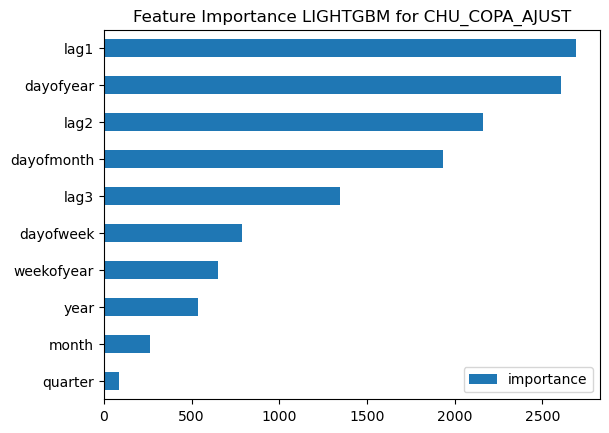

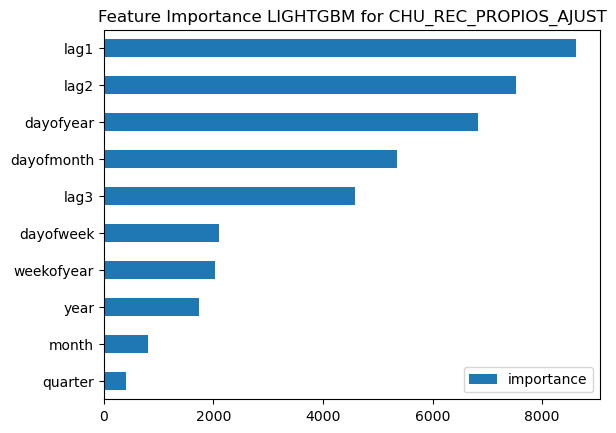

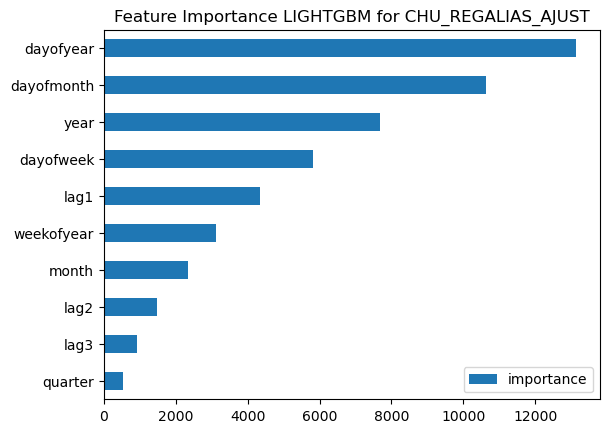

In [204]:
models = [lgb_copa, lgb_rec_propios, lgb_regalias]
i = 0
for model in models:
    
    feature_names = model.booster_.feature_name()  # Obtiene nombres desde el modelo interno de LightGBM
    fi = pd.DataFrame(data=model.feature_importances_,
                    index=feature_names,
                    columns=['importance'])
    fi.sort_values('importance').plot(kind='barh', title=f'Feature Importance LIGHTGBM for {titulos[i]}')
    i += 1
    plt.show()


In [205]:
def plotear_predicciones(df_aux, model, X_test):
    df = df_aux.copy()
    test = df.copy()
    test['predictionLGBM'] = model.predict(X_test)
    df = df.merge(test[['predictionLGBM']], how='left', left_index=True, right_index=True)
    ax = df[df.columns[0]].plot(figsize=(15, 5))
    df['predictionLGBM'].plot(ax=ax)
    plt.legend(['Truth Data', 'predictionLGBM'])
    ax.set_title('Raw Dat and predictionLGBM')
    plt.show()

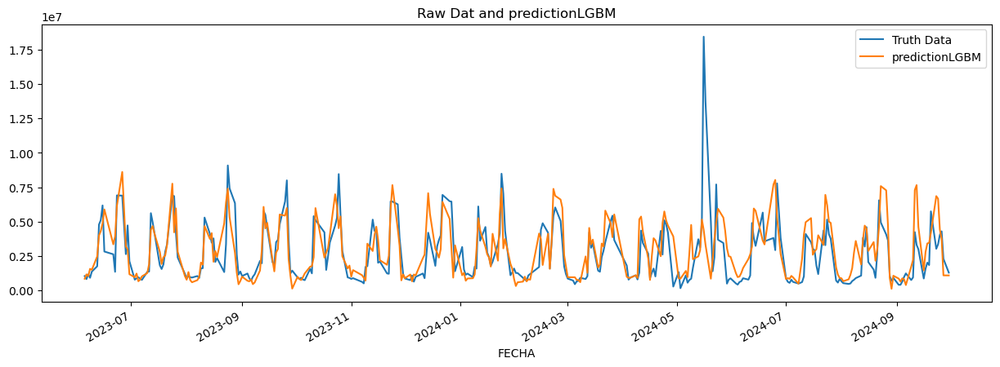

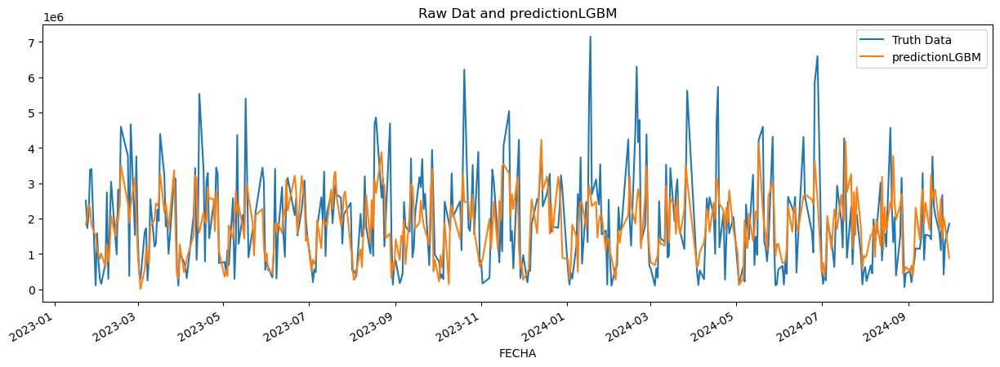

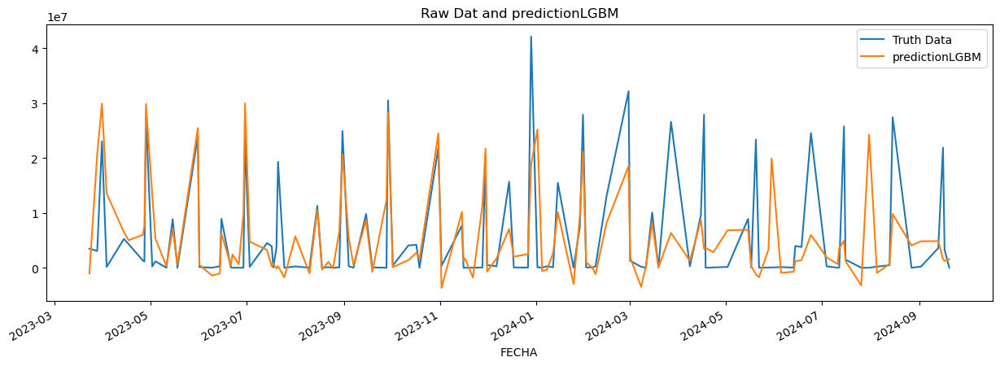

In [ ]:
models = [lgb_copa, lgb_rec_propios, lgb_regalias]
X_test = [X_test_COPA, X_test_REC_PROPIOS, X_test_REGALIAS]

for i in range(len(dataframes)):
    plotear_predicciones(dataframes_test[i], models[i], X_test[i])

In [ ]:
import seaborn as sns

def plot_train_test_predictions(dataframes_train, dataframes_test, predictions_test, series_names, start_date=None):
  
    num_series = len(dataframes_train)
    fig, axes = plt.subplots(1, num_series, figsize=(20, 6), sharey=True)
    sns.set(style="whitegrid")

    for i in range(num_series):
        ax = axes[i]

        # Filtrar datos desde la fecha indicada (si se especifica)
        train = dataframes_train[i][start_date:] if start_date else dataframes_train[i]
        test = dataframes_test[i][start_date:] if start_date else dataframes_test[i]
        pred = predictions_test[i][start_date:] if start_date else predictions_test[i]
        # Graficar series
        #sns.lineplot(data=train, label='Train', ax=ax, color='#3477eb')
        #sns.lineplot(data=test, label='Test', ax=ax, color='green')
        #sns.lineplot(data=pred, ax=ax, color='#f72525', linestyle='--')
        ax.plot(train, label='Train', color='#3477eb')
        ax.plot(test, label='Test', color='green')
        ax.plot(pred, label='Predicciones', color='red', linestyle='--')
        
        # Configuración del gráfico
        ax.set_title(series_names[i], fontsize=14)
        ax.set_xlabel('Fecha')
        ax.set_ylabel('Valor')
        ax.legend(loc='best')
        ax.grid(True)

    plt.tight_layout()
    plt.show()

In [40]:
import matplotlib.pyplot as plt
import seaborn as sns

def plot_train_test_predictions(dataframes_train, dataframes_test, predictions_test, series_names, target_column, start_date=None):
    """
    Grafica las series de entrenamiento, prueba y predicciones.
    
    Parámetros:
    - dataframes_train: Lista de dataframes con los datos de entrenamiento.
    - dataframes_test: Lista de dataframes con los datos de prueba.
    - predictions_test: Lista de arreglos con las predicciones.
    - series_names: Lista de nombres para las series (uno por gráfico).
    - target_column: Nombre de la columna objetivo a graficar.
    - start_date: Fecha de inicio para filtrar las series (opcional).
    """
    sns.set(style="whitegrid")
    num_series = len(dataframes_train)
    fig, axes = plt.subplots(1, num_series, figsize=(20, 6), sharey=True)

    for i in range(num_series):
        ax = axes[i]

        # Filtrar datos desde la fecha indicada
        train = dataframes_train[i][titulos[i]][start_date:] if start_date else dataframes_train[i][titulos[i]]
        test = dataframes_test[i][titulos[i]][start_date:] if start_date else dataframes_test[i][titulos[i]]
        pred = predictions_test[i]  # Asumimos que ya tiene las predicciones alineadas con el índice de prueba
        
        # Graficar series
        ax.plot(train.index, train.values, label='Train', color='#3477eb')
        ax.plot(test.index, test.values, label='Test', color='green')
        ax.plot(test.index, pred, label='Predicciones', color='red', linestyle='--')

        # Configuración del gráfico
        ax.set_title(series_names[i], fontsize=14)
        ax.set_xlabel('Fecha')
        ax.set_ylabel('Valor')
        ax.legend(loc='best')
        ax.grid(True)

    plt.tight_layout()
    plt.show()


In [42]:
# models = [lgb_copa, lgb_rec_propios, lgb_regalias]
# X_test = [X_test_COPA, X_test_REC_PROPIOS, X_test_REGALIAS]
# X_train = [X_train_COPA, X_train_REC_PROPIOS, X_train_REGALIAS]
# y_pred_copa = lgb_copa.predict(X_test_COPA)
# y_pred_rec_propios = lgb_rec_propios.predict(X_test_REC_PROPIOS)
# y_pred_regalias = lgb_regalias.predict(X_test_REGALIAS)
# y_pred = [y_pred_copa, y_pred_rec_propios, y_pred_regalias]


# plot_train_test_predictions(
#     dataframes_train,       # Lista de dataframes de entrenamiento
#     dataframes_test,        # Lista de dataframes de prueba
#     y_pred,        # Lista de arreglos con las predicciones
#     titulos,       # Lista de nombres para los gráficos
#     target_column='hola',  # Nombre de la columna objetivo
#     start_date='2023-10-01'          # Fecha de inicio opcional
# )
    

In [207]:
from sklearn.metrics import mean_absolute_error as mae

models = [lgb_copa, lgb_rec_propios, lgb_regalias]
X_test = [X_test_COPA, X_test_REC_PROPIOS, X_test_REGALIAS]
y_test = [y_test_COPA, y_test_REC_PROPIOS, y_test_REGALIAS]

for i in range(len(models)):       
    rmse_score = np.sqrt(mean_squared_error(y_test[i], model.predict(X_test[i])))
    mae_score = mae(y_test[i], model.predict(X_test[i]))
    print(f'RMSE en conjunto de Test Modelo LGBM: {rmse_score:0.2f}')
    print(f'MAE en conjunto de Test Modelo LGBM: {mae_score:0.2f}')
    print('--------------')

RMSE en conjunto de Test Modelo LGBM: 6913661.67
MAE en conjunto de Test Modelo LGBM: 4510578.43
--------------
RMSE en conjunto de Test Modelo LGBM: 7101702.04
MAE en conjunto de Test Modelo LGBM: 4449258.78
--------------
RMSE en conjunto de Test Modelo LGBM: 8182411.03
MAE en conjunto de Test Modelo LGBM: 4947123.04
--------------


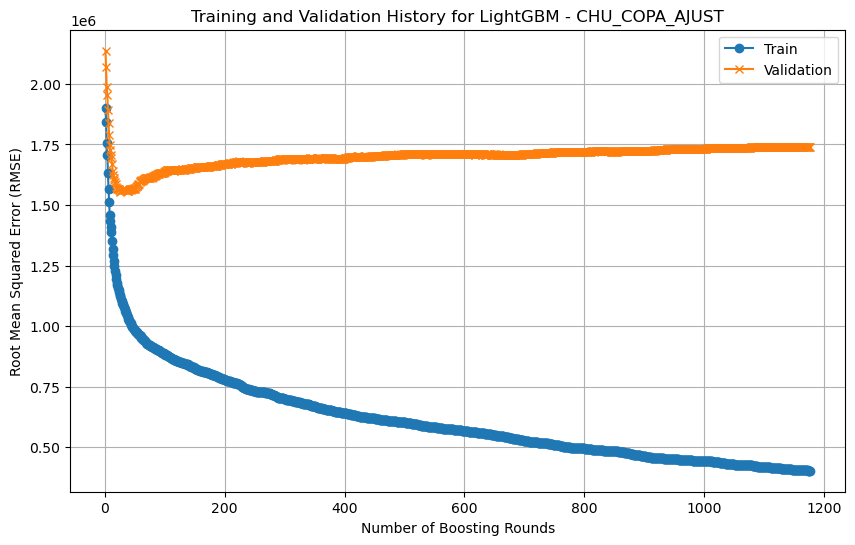

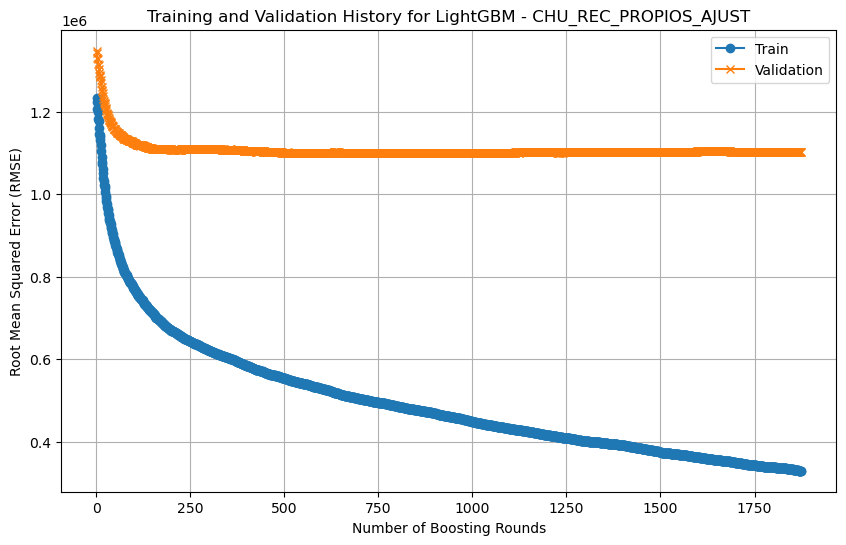

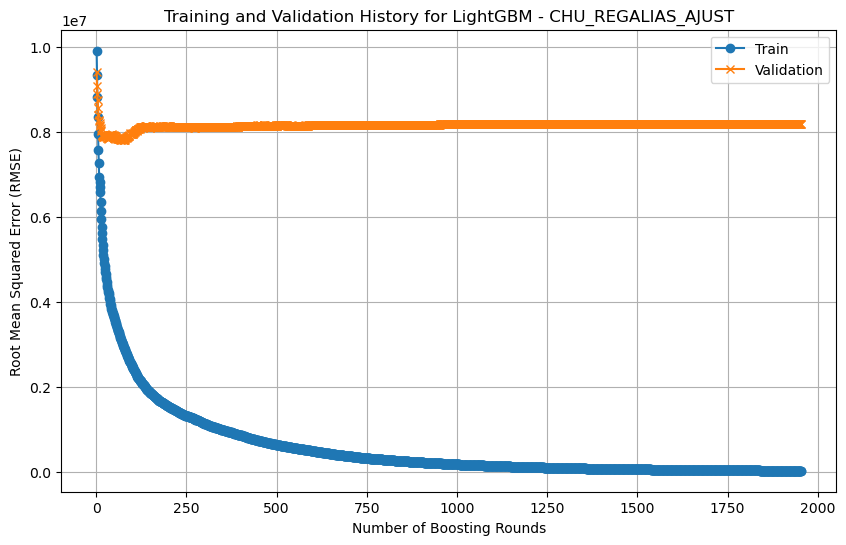

In [208]:
models = [lgb_copa, lgb_rec_propios, lgb_regalias]

for i in range(len(models)):

    # Obtener los resultados de evaluación del modelo
    results = models[i].evals_result_  # 'reg_lightgbm' es tu modelo LightGBM entrenado

    # Extraer los errores de entrenamiento y validación
    train_error = results['training']['rmse']  # Asumiendo que usaste RMSE como métrica
    val_error = results['valid_1']['rmse']  # 'valid_1' corresponde al conjunto de validación

    # Número de rondas de boosting
    epoch = range(1, len(train_error) + 1)

    # Crear el gráfico
    plt.figure(figsize=(10, 6))
    plt.plot(epoch, train_error, label='Train', marker='o')
    plt.plot(epoch, val_error, label='Validation', marker='x')
    plt.xlabel('Number of Boosting Rounds')
    plt.ylabel('Root Mean Squared Error (RMSE)')
    plt.title(f'Training and Validation History for LightGBM - {titulos[i]}')
    plt.legend()
    plt.grid()
    plt.show()


In [ ]:
dataframes[2].index.max()

Timestamp('2024-09-20 00:00:00')

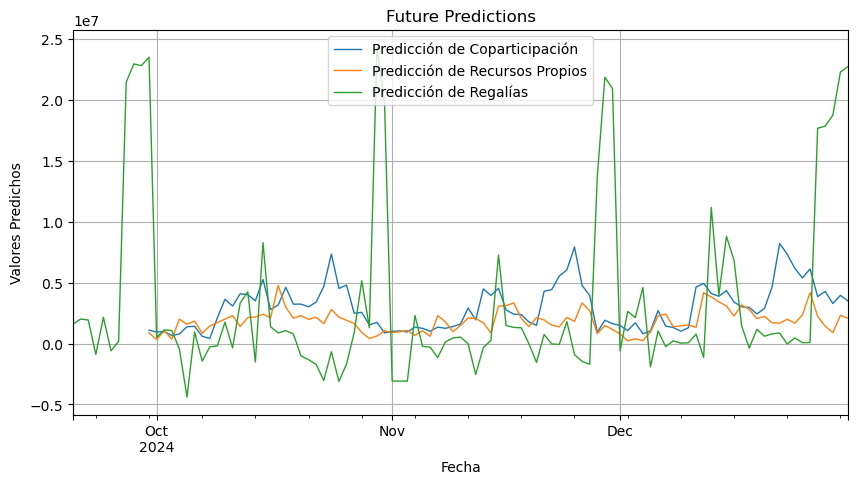

In [209]:
import matplotlib.pyplot as plt

models = [lgb_copa, lgb_rec_propios, lgb_regalias]
titles = ["Predicción de Coparticipación", "Predicción de Recursos Propios", "Predicción de Regalías"]

plt.figure(figsize=(10, 5))  # Crear una figura para graficar

for i in range(len(models)):
    df_aux = dataframes[i].copy()
    df_aux.drop(columns=['dayofweek', 'quarter', 'month', 'year', 'dayofyear', 
                         'dayofmonth', 'weekofyear', 'lag1', 'lag2', 'lag3'], inplace=True)
    
    # Generar datos futuros
    future = pd.date_range(dataframes[i].index.max(), '2024-12-31', freq='1d')
    future_df = pd.DataFrame(index=future)
    future_df['isFuture'] = True
    df_aux['isFuture'] = False
    df_and_future = pd.concat([df_aux, future_df])
    
    # Agregar características de tiempo y lags
    time_features = df_and_future.index.to_series().apply(extract_time_features)
    df_and_future = pd.concat([df_and_future, time_features], axis=1)
    df_and_future = add_lags(df_and_future, titulos[i]) 
    
    # Predicciones futuras
    future_w_features = df_and_future.query('isFuture').copy()
    future_w_features['pred'] = models[i].predict(future_w_features[FEATURES])
    
    # Graficar las predicciones
    future_w_features['pred'].plot(
        ms=1,
        lw=1,
        label=titles[i]  # Etiqueta para la leyenda
    )

# Personalizar el gráfico
plt.title("Future Predictions")
plt.xlabel("Fecha")
plt.ylabel("Valores Predichos")
plt.legend()  # Mostrar leyenda
plt.grid(True)
plt.show()
